In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency
import plotly.express as px
import seaborn as sns

# Load dataset
df = pd.read_csv('train.csv')  # Replace with your actual file path


### correlation categories

In [3]:
from scipy.stats import chi2_contingency

# Function to calculate Cramér's V
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))    
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

# Collect results
results = []

for col in df.columns:
    if col != 'BsmtFinType1':
        try:
            if df[col].dtype.name == 'category' or df[col].dtype == object:
                score = cramers_v(df['BsmtFinType1'], df[col])
                results.append((col, score))
        except Exception as e:
            continue  # Skip columns where Cramér’s V fails

# Sort by strongest association
results = sorted(results, key=lambda x: x[1], reverse=True)

# Display results
for col, score in results:
    print(f"Cramér's V between 'BsmtFinType1' and '{col}': {score:.3f}")

Cramér's V between 'BsmtFinType1' and 'BsmtQual': 0.333
Cramér's V between 'BsmtFinType1' and 'Foundation': 0.315
Cramér's V between 'BsmtFinType1' and 'Neighborhood': 0.313
Cramér's V between 'BsmtFinType1' and 'ExterQual': 0.292
Cramér's V between 'BsmtFinType1' and 'KitchenQual': 0.276
Cramér's V between 'BsmtFinType1' and 'GarageFinish': 0.258
Cramér's V between 'BsmtFinType1' and 'MasVnrType': 0.254
Cramér's V between 'BsmtFinType1' and 'Exterior2nd': 0.223
Cramér's V between 'BsmtFinType1' and 'Alley': 0.222
Cramér's V between 'BsmtFinType1' and 'Exterior1st': 0.216
Cramér's V between 'BsmtFinType1' and 'BsmtFinType2': 0.213
Cramér's V between 'BsmtFinType1' and 'HeatingQC': 0.202
Cramér's V between 'BsmtFinType1' and 'BsmtExposure': 0.199
Cramér's V between 'BsmtFinType1' and 'MiscFeature': 0.198
Cramér's V between 'BsmtFinType1' and 'CentralAir': 0.175
Cramér's V between 'BsmtFinType1' and 'PavedDrive': 0.174
Cramér's V between 'BsmtFinType1' and 'FireplaceQu': 0.164
Cramér's V

## 1.1 convert types

In [4]:
#from Id	LotArea	LotShape	BldgType	HouseStyle	BsmtFinSF1	BsmtFinType2	BsmtFinSF2	BsmtUnfSF	TotalBsmtSF	1stFlrSF	2ndFlrSF	
#GrLivArea	BsmtFullBath	BsmtHalfBath	FullBath	HalfBath	BedroomAbvGr	KitchenAbvGr	TotRmsAbvGrd	GarageCars	GarageArea
#we drop

df[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']] = df[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']].astype('object')

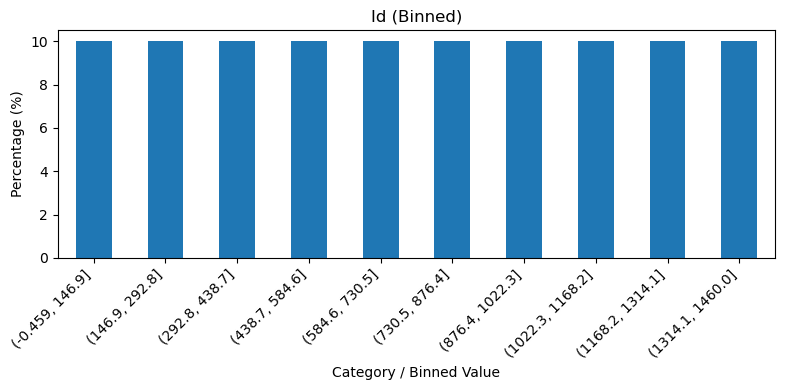

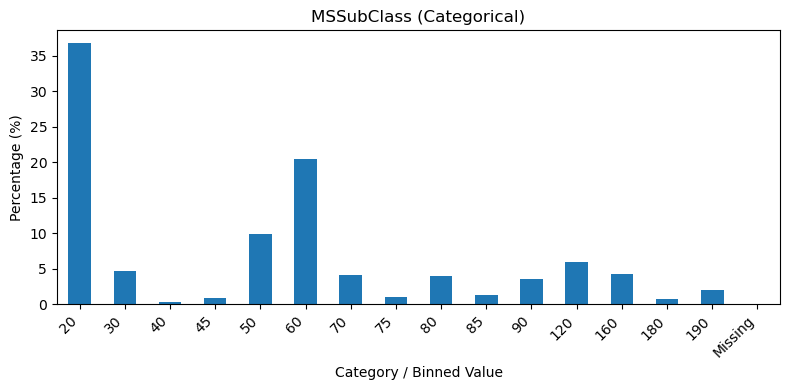

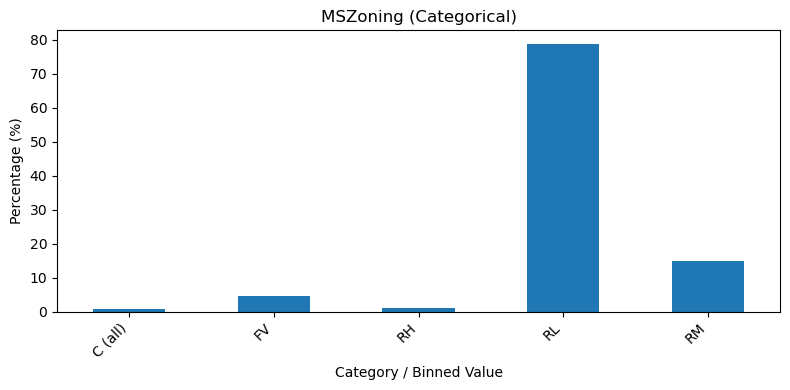

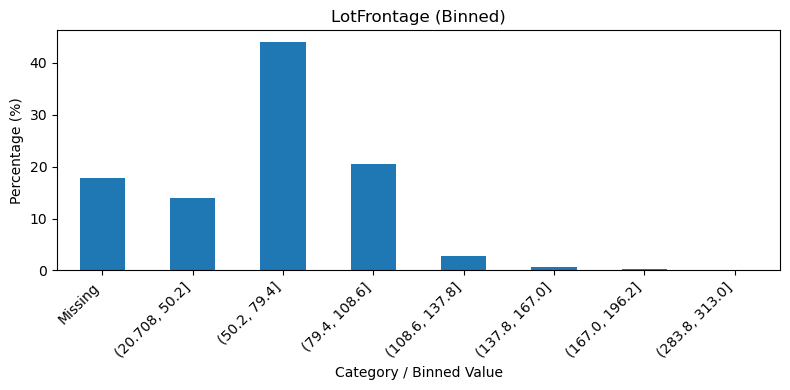

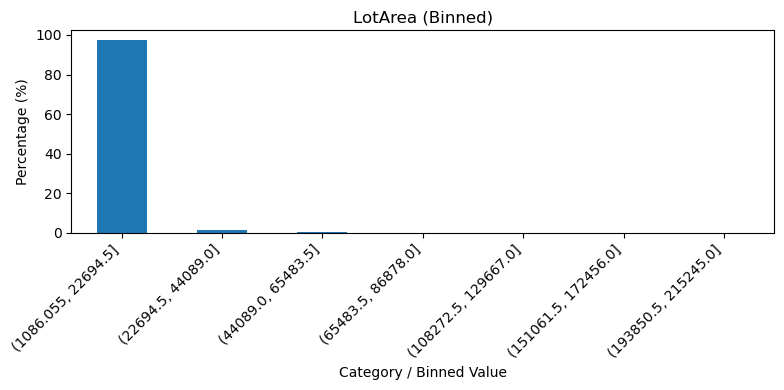

...

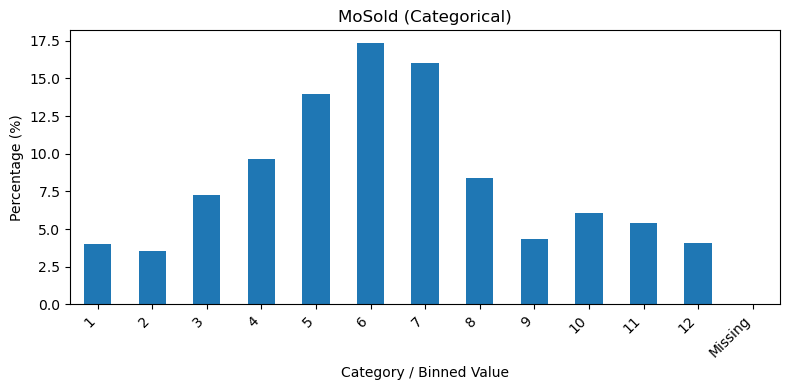

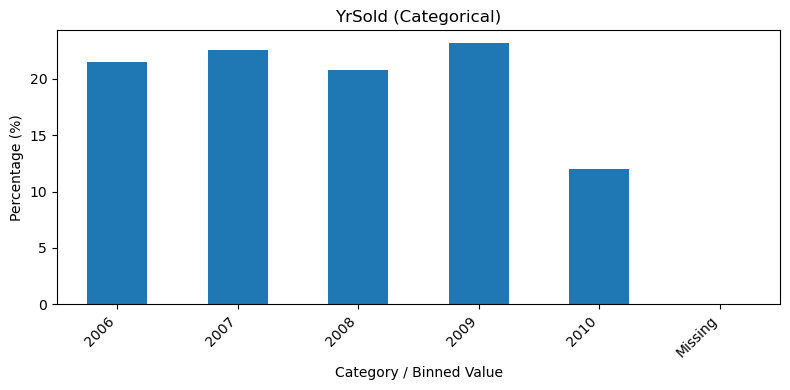

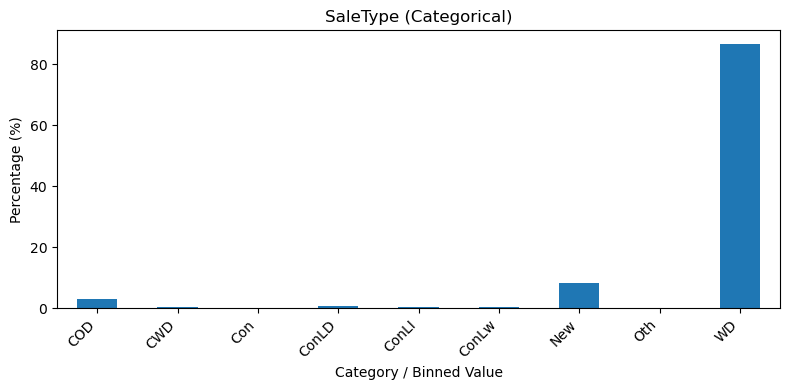

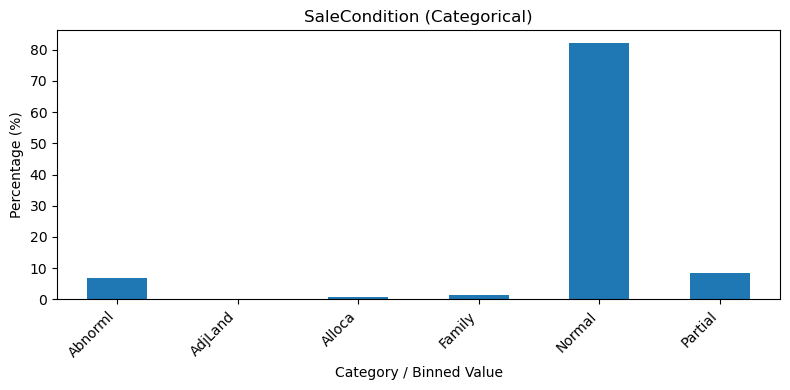

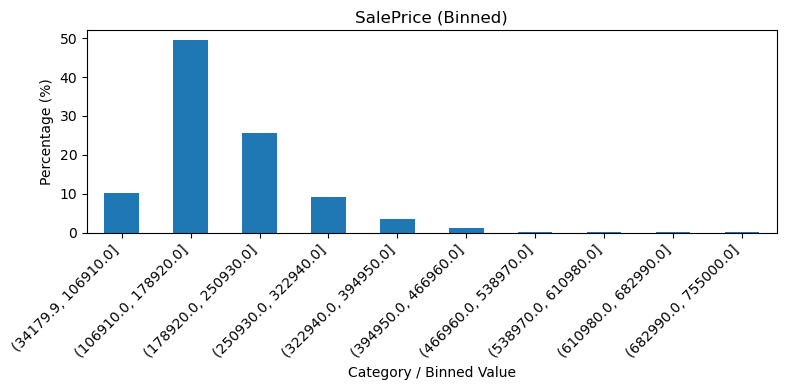

In [ ]:
# Define number of bins for numerical variables
num_bins = 10

# Iterate through each column
for col in df.columns:
    plt.figure(figsize=(8, 4))

    if pd.api.types.is_numeric_dtype(df[col]):
        # Bin non-missing values
        binned = pd.cut(df[col].dropna(), bins=num_bins)
        binned = binned.astype(str)

        # Add 'Missing' label
        binned_full = pd.Series(binned, index=df[col].dropna().index)
        binned_full = binned_full.reindex(df.index).fillna('Missing')

        # Value counts with missing included
        value_counts = binned_full.value_counts(normalize=True) * 100

        # Custom sort: extract numeric lower bounds for sorting
        value_counts = value_counts.sort_index(key=lambda x: x.map(lambda y: float(y.split(',')[0].strip('(')) if y != 'Missing' else float('-inf')))

        value_counts.plot(kind='bar')
        plt.title(f'{col} (Binned)')

    else:
        # Categorical with NaNs
        value_counts = df[col].value_counts(normalize=True, dropna=False) * 100
        value_counts.index = value_counts.index.fillna('Missing').astype(str)

        # Define custom sort orders for known columns
        if col == 'MoSold':
            order = [str(i) for i in range(1, 13)] + ['Missing']
            value_counts = value_counts.reindex(order).fillna(0)

        elif col == 'YrSold':
            years = sorted(df[col].dropna().astype(int).unique())
            order = [str(y) for y in years] + ['Missing']
            value_counts = value_counts.reindex(order).fillna(0)

        elif col == 'MSSubClass':
            classes = sorted(df[col].dropna().astype(int).unique())
            order = [str(c) for c in classes] + ['Missing']
            value_counts = value_counts.reindex(order).fillna(0)

        else:
            value_counts = value_counts.sort_index()

        value_counts.plot(kind='bar')
        plt.title(f'{col} (Categorical)')

    plt.ylabel('Percentage (%)')
    plt.xlabel('Category / Binned Value')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

In [4]:
#Lotaerea not clear in binned, (include basement and floor aerea?)
#overall qual, cond on 10
#YearBuilt, plupart b3d 2000 not clear
#year remodeled, not clear
#1flaerea, mohom or not, correlated with lot aerea?
#rooms above ground
#combine month year
#BsmtFinType1 maybe keep it later


In [5]:
#remove id
#MSSubClass

### viz

C:\Users\berra\AppData\Local\Temp\ipykernel_17588\2370649598.py:10: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_copy[cat_cols] = df_copy[cat_cols].fillna('Missing')


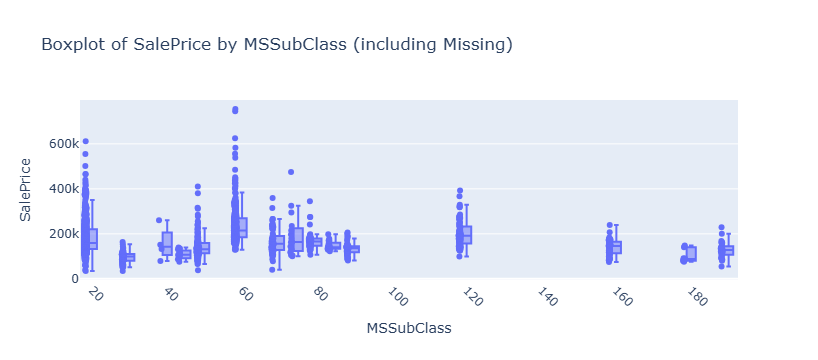

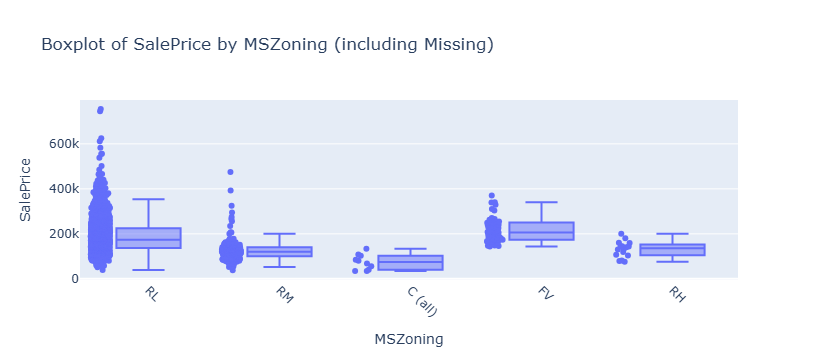

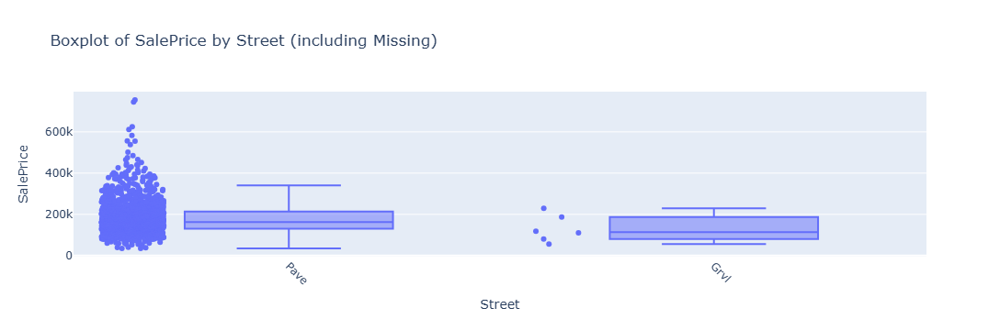

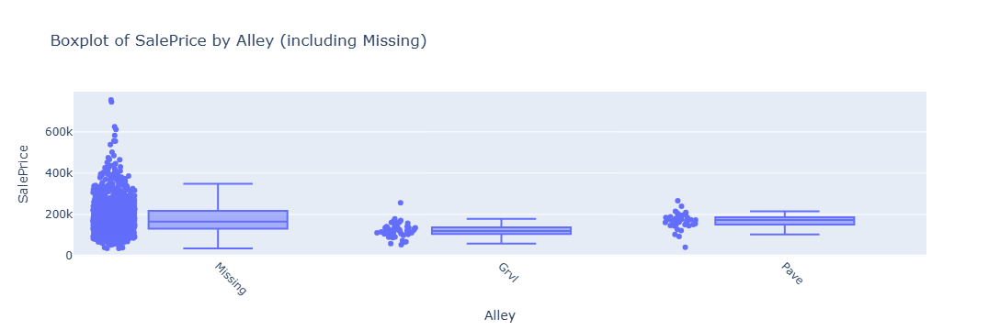

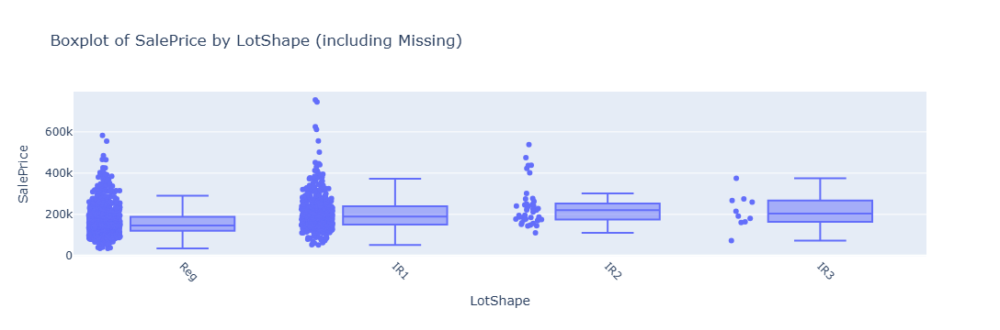

...

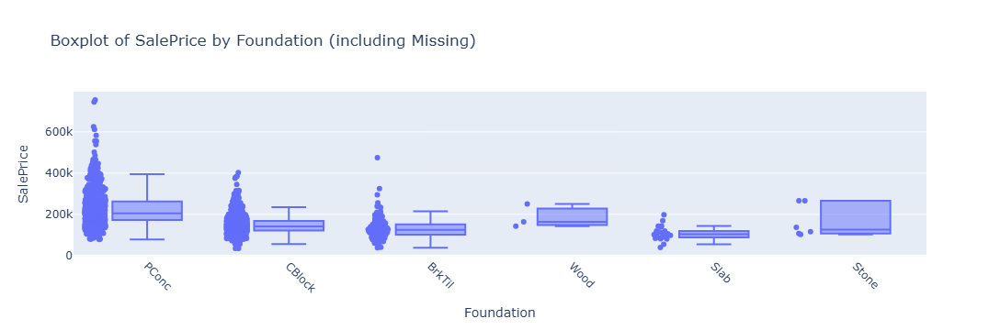

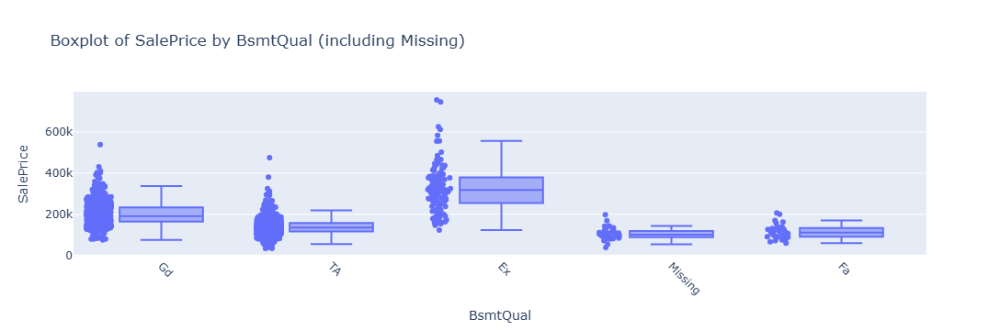

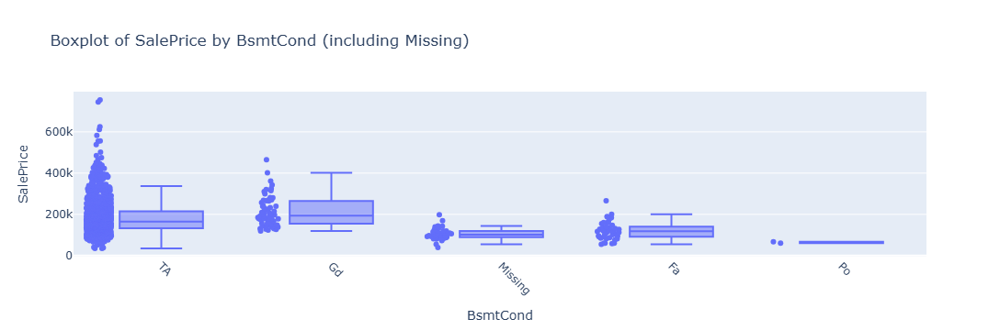

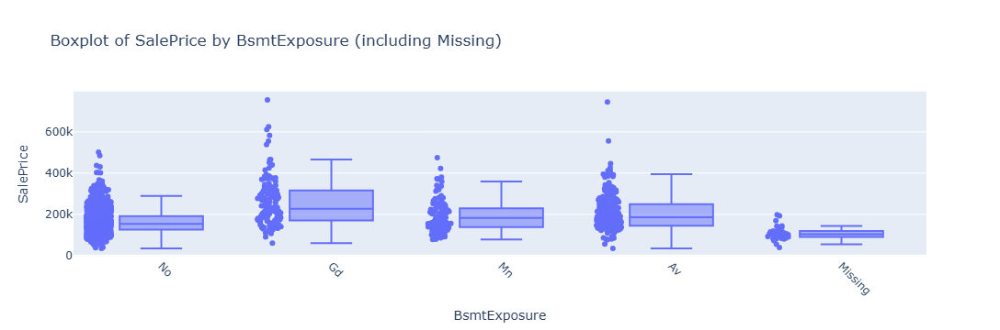

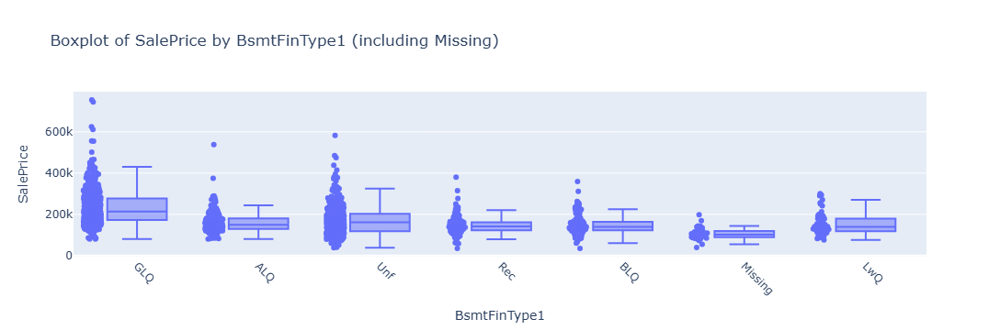

In [5]:
#viz
# Target variable
target_col = 'SalePrice'

# Select categorical columns
cat_cols = df.select_dtypes(include=['object']).columns

# Make a copy and handle missing values
df_copy = df.copy()
df_copy[cat_cols] = df_copy[cat_cols].fillna('Missing')

# Plot interactive boxplots
for col in cat_cols:
    fig = px.box(df_copy, x=col, y=target_col, points='all', title=f"Boxplot of {target_col} by {col} (including Missing)")
    fig.update_layout(xaxis_tickangle=45)
    fig.show()
        #where mssubclass
    #we remove MSZoning hmm, Street, Alley, LotShape, LandContour, LotShape (keep eye on ir2, bas prix), LandContour (low weird), Utilities (other none),
    #LotConfig, LandSlope (Mod bas), Condition1 (hmm), Condition2, BldgType, HouseStyle (Split is low price), RoofStyle, RoofMatl, ExterCond, B
    #remove BsmtFinSF1, Heating (more in link with year construction), CentralAir, Electrical(more in link with year construction), 
    #Functional(severly damaged), GarageType (more do with surface), PoolQC (keep in mind), SaleCondition (abnormal mohima)
    #SaleType (have info in year built, new)

In [7]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2, _, _, _ = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k-1, r-1))

# Example usage:
cramers_v(df['Exterior1st'], df['Exterior2nd'])
#so we keep only 'Exterior1st'


0.7620101123416536

In [8]:
# Function to calculate Cramér's V
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))    
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

# Collect results
results = []

for col in df.columns:
    if col != 'BsmtFinType1':
        try:
            if df[col].dtype.name == 'category' or df[col].dtype == object:
                score = cramers_v(df['BsmtFinType1'], df[col])
                results.append((col, score))
        except Exception as e:
            continue  # Skip columns where Cramér’s V fails

# Sort by strongest association
results = sorted(results, key=lambda x: x[1], reverse=True)

# Display results
for col, score in results:
    print(f"Cramér's V between 'BsmtFinType1' and '{col}': {score:.3f}")

Cramér's V between 'BsmtFinType1' and 'YearBuilt': 0.364
Cramér's V between 'BsmtFinType1' and 'BsmtQual': 0.333
Cramér's V between 'BsmtFinType1' and 'Foundation': 0.315
Cramér's V between 'BsmtFinType1' and 'Neighborhood': 0.313
Cramér's V between 'BsmtFinType1' and 'ExterQual': 0.292
Cramér's V between 'BsmtFinType1' and 'YearRemodAdd': 0.289
Cramér's V between 'BsmtFinType1' and 'KitchenQual': 0.276
Cramér's V between 'BsmtFinType1' and 'GarageFinish': 0.258
Cramér's V between 'BsmtFinType1' and 'MasVnrType': 0.254
Cramér's V between 'BsmtFinType1' and 'Exterior2nd': 0.223
Cramér's V between 'BsmtFinType1' and 'Alley': 0.222
Cramér's V between 'BsmtFinType1' and 'MSSubClass': 0.218
Cramér's V between 'BsmtFinType1' and 'Exterior1st': 0.216
Cramér's V between 'BsmtFinType1' and 'BsmtFinType2': 0.213
Cramér's V between 'BsmtFinType1' and 'HeatingQC': 0.202
Cramér's V between 'BsmtFinType1' and 'BsmtExposure': 0.199
Cramér's V between 'BsmtFinType1' and 'MiscFeature': 0.198
Cramér's V

In [9]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2, _, _, _ = chi2_contingency(confusion_matrix)
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k-1, r-1))

# Example usage:
cramers_v(df['Exterior1st'], df['Exterior2nd'])
#so we keep only 'Exterior1st'

0.7620101123416536

In [10]:
corr = df['GarageArea'].corr(df['GrLivArea'], method='pearson')
print(f"Pearson correlation: {corr:.3f}")

Pearson correlation: 0.469


### type of columns

In [11]:
for dtype in df.dtypes.unique():
    cols = df.select_dtypes(include=[dtype]).columns.tolist()
    print(f"{dtype}: {cols}")

int64: ['Id', 'LotArea', 'OverallQual', 'OverallCond', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'SalePrice']
object: ['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'F

In [12]:
df.select_dtypes(include='int64').head()

,Id,LotArea,OverallQual,OverallCond,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,...,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,SalePrice
0,1,8450,7,5,706,0,150,856,856,854,...,2,548,0,61,0,0,0,0,0,208500
1,2,9600,6,8,978,0,284,1262,1262,0,...,2,460,298,0,0,0,0,0,0,181500
2,3,11250,7,5,486,0,434,920,920,866,...,2,608,0,42,0,0,0,0,0,223500
3,4,9550,7,5,216,0,540,756,961,756,...,3,642,0,35,272,0,0,0,0,140000
4,5,14260,8,5,655,0,490,1145,1145,1053,...,3,836,192,84,0,0,0,0,0,250000


# nan

In [13]:
# Check for columns with NaNs
missing_cols = df.columns[df.isna().any()]
print("Columns with missing values:")
print(missing_cols)

# Optional: see how many missing values per column
print("\nMissing value counts:")
print(df[missing_cols].isna().sum())

missing_percent = df.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

Columns with missing values:
Index(['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence',
       'MiscFeature'],
      dtype='object')

Missing value counts:
LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64
Missing value percentage per column:
PoolQC          99.52
MiscFeature     96.30
Alley           93.77
Fence           80.75
MasVnrType      59.73
FireplaceQu     47.26
LotFrontage     17.74
GarageType       5.55
Garag

## 1.2 drop most missing

In [3]:
threshold = 0.30  # 30%
df = df.loc[:, df.isna().mean() <= threshold]

threshold = 0.30  # 30%
missing_ratio = df.isna().mean()

# Columns to drop (more than 30% missing)
dropped_columns_most_missing = missing_ratio[missing_ratio > threshold].index.tolist()

# Drop from training data
df = df.loc[:, missing_ratio <= threshold]

In [14]:
# Check for columns with NaNs
missing_cols = df.columns[df.isna().any()]
print("Columns with missing values:")
print(missing_cols)

# Optional: see how many missing values per column
print("\nMissing value counts:")
print(df[missing_cols].isna().sum())

missing_percent = df.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

Columns with missing values:
Index(['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence',
       'MiscFeature'],
      dtype='object')

Missing value counts:
LotFrontage      259
Alley           1369
MasVnrType       872
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64
Missing value percentage per column:
PoolQC          99.52
MiscFeature     96.30
Alley           93.77
Fence           80.75
MasVnrType      59.73
FireplaceQu     47.26
LotFrontage     17.74
GarageType       5.55
Garag

## 1.3 fill na categorical

In [5]:
# Identify categorical columns
cat_cols = df.select_dtypes(include=['object', 'category']).columns

# Fill missing values with "Missing"
df[cat_cols] = df[cat_cols].fillna("Missing")

C:\Users\berra\AppData\Local\Temp\ipykernel_18016\1573740208.py:5: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df[cat_cols] = df[cat_cols].fillna("Missing")


In [16]:
# Check for columns with NaNs
missing_cols = df.columns[df.isna().any()]
print("Columns with missing values:")
print(missing_cols)

# Optional: see how many missing values per column
print("\nMissing value counts:")
print(df[missing_cols].isna().sum())

missing_percent = df.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

Columns with missing values:
Index(['LotFrontage', 'MasVnrArea', 'GarageYrBlt'], dtype='object')

Missing value counts:
LotFrontage    259
MasVnrArea       8
GarageYrBlt     81
dtype: int64
Missing value percentage per column:
LotFrontage    17.74
GarageYrBlt     5.55
MasVnrArea      0.55
dtype: float64


## 1.4 keep means for missing quantitative + use them train

In [6]:
#save numeric means for missing test
means = df.select_dtypes(include='number').mean()

#imputer numeric par moyenne dans train
df = df.fillna(df.select_dtypes(include='number').mean())

In [18]:
# Check for columns with NaNs
missing_cols = df.columns[df.isna().any()]
print("Columns with missing values:")
print(missing_cols)

# Optional: see how many missing values per column
print("\nMissing value counts:")
print(df[missing_cols].isna().sum())

missing_percent = df.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

Columns with missing values:
Index([], dtype='object')

Missing value counts:
Series([], dtype: float64)
Missing value percentage per column:
Series([], dtype: float64)


# Outliers

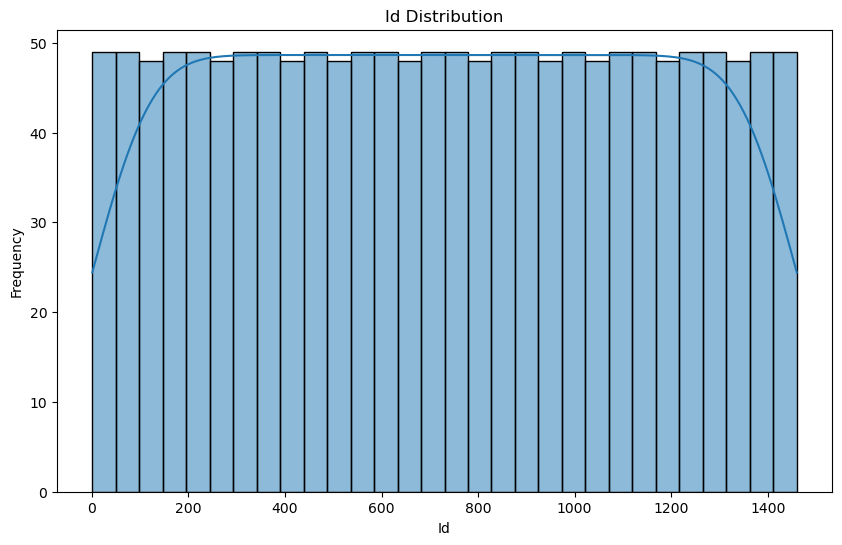

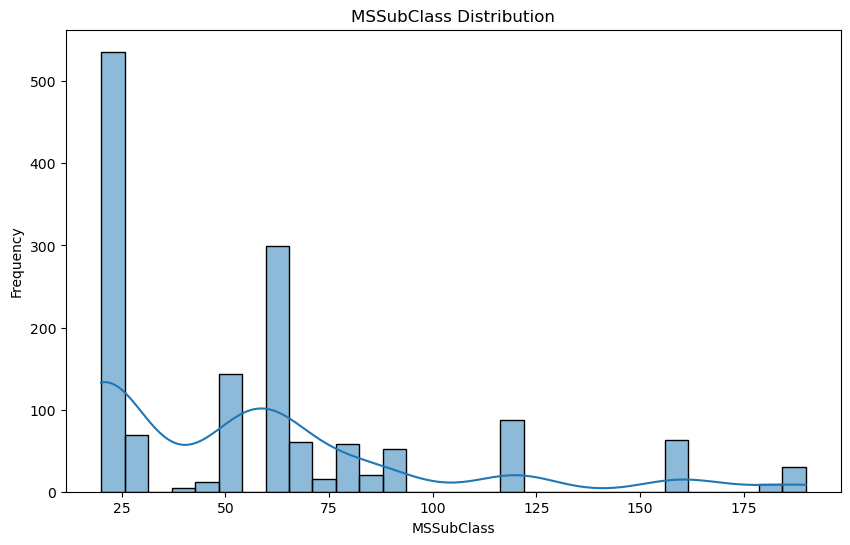

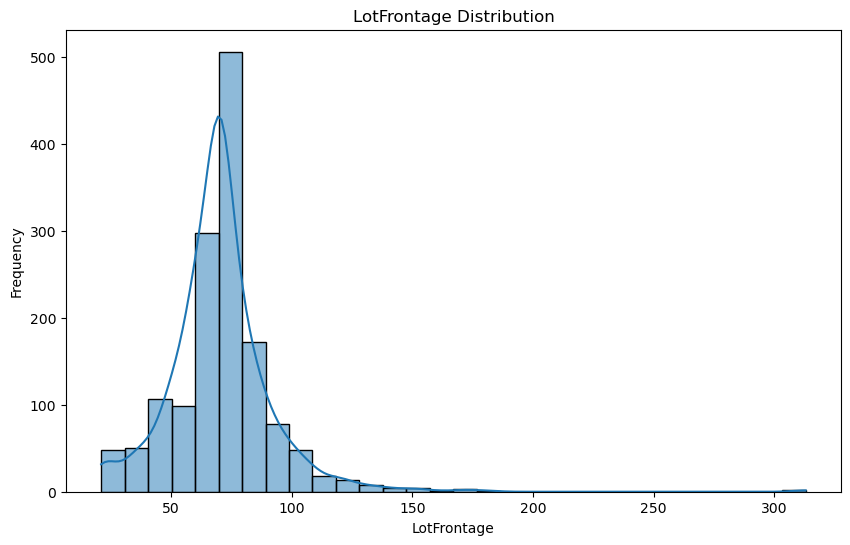

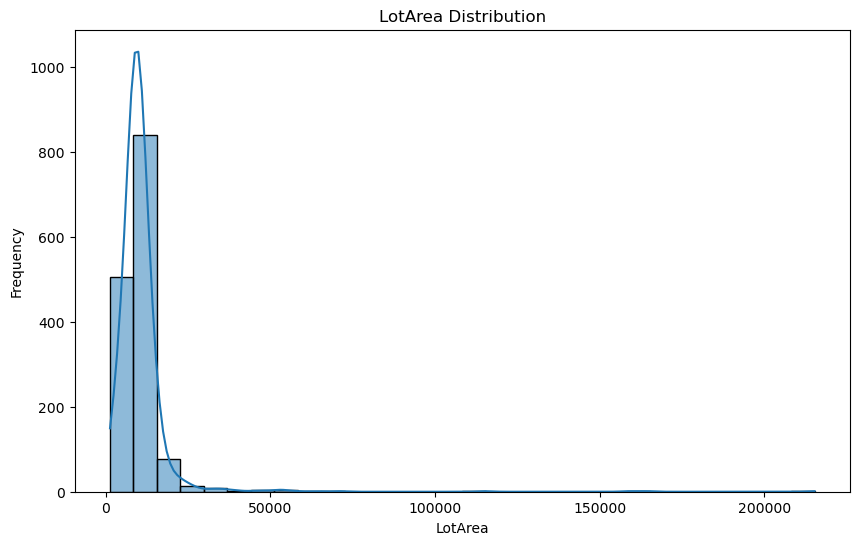

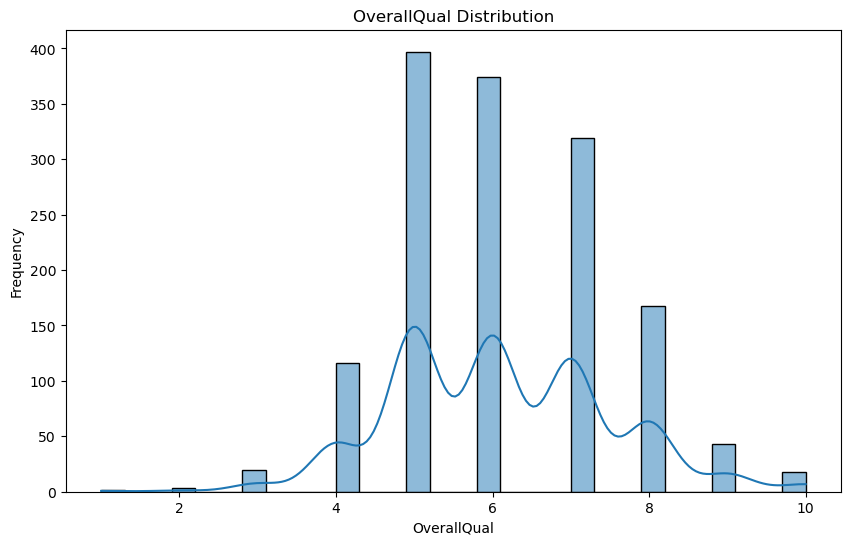

...

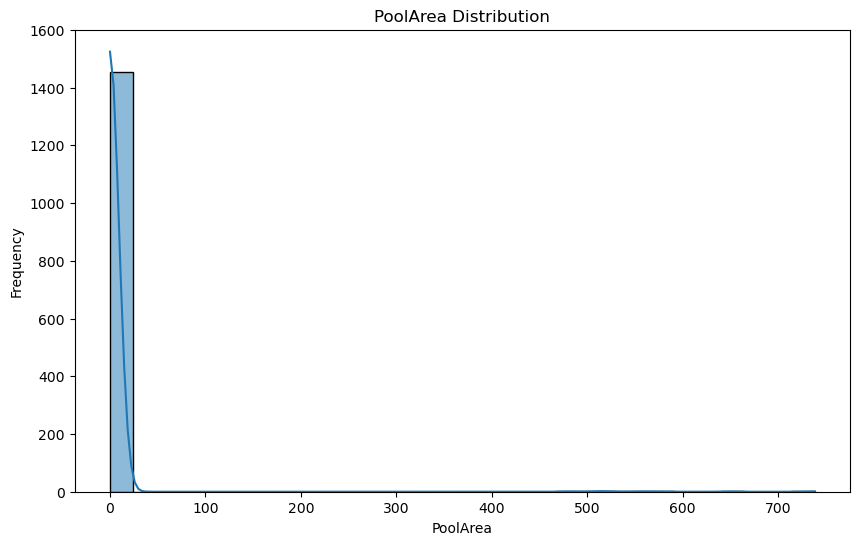

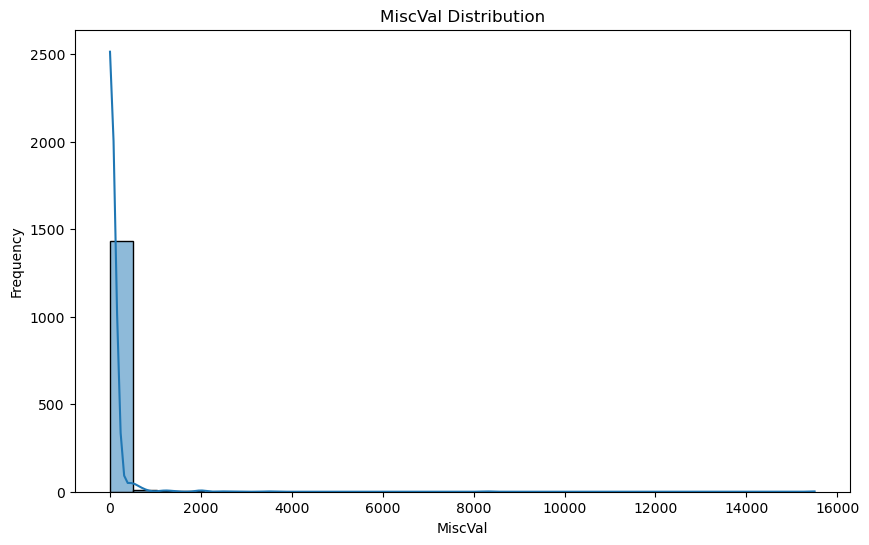

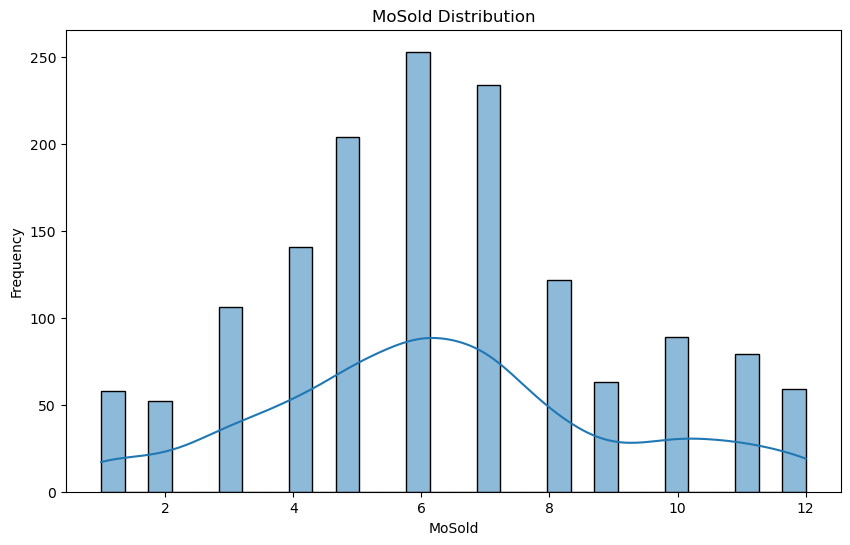

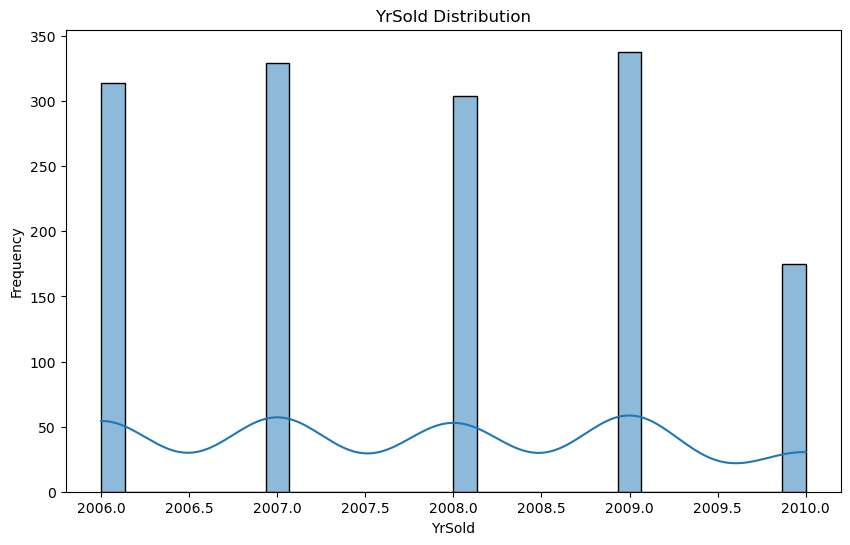

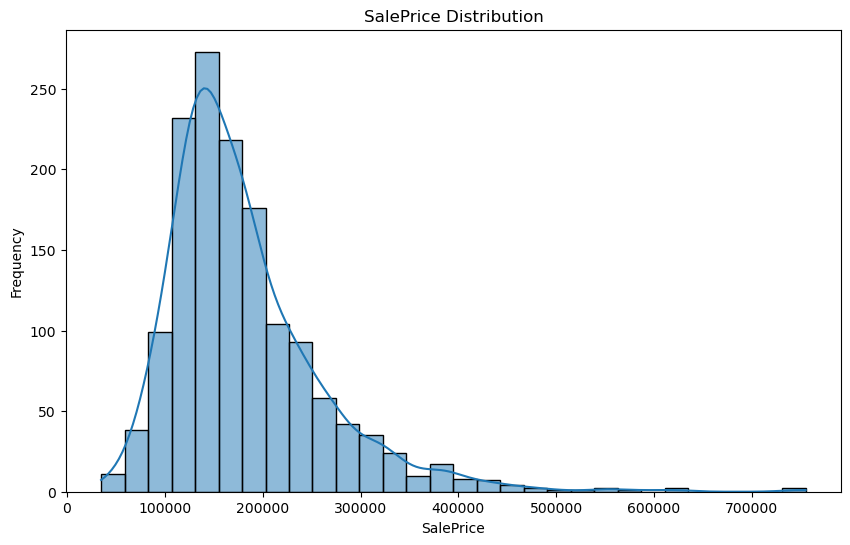

In [19]:
df_dropped = df.copy()
for col in df_dropped.select_dtypes(include=['number']).columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(df[col], bins=30, kde=True)
    plt.title(f'{col} Distribution')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

## 1.5 create variables

In [20]:
#'YearBuilt', 'YearRemodAdd, 'MoSold', 'YrSold' convert to quantitative
# List of columns to convert
columns_to_convert = ['YearBuilt', 'YearRemodAdd', 'MoSold', 'YrSold']

# Convert each to integer safely
for col in columns_to_convert:
    df_dropped.loc[:, col] = df_dropped[col].astype(int)

# Set reference year
reference_year = df_dropped['YrSold'].max()

# Create quantitative features safely
df_dropped.loc[:, 'HouseAge'] = reference_year - df_dropped['YearBuilt']
df_dropped.loc[:, 'YearsSinceRemod'] = reference_year -df_dropped['YearRemodAdd']
df_dropped.loc[:, 'TimeIndex'] = (
    (df_dropped['YrSold'] - df_dropped['YrSold'].min()) * 12 + df_dropped['MoSold']
)

df_dropped = df_dropped.drop([
    'YearBuilt', 'YearRemodAdd', 'YrSold', 'MoSold'
], axis=1) 

# Convert object columns to numeric, forcing errors to NaN
cols_to_convert = ['HouseAge', 'YearsSinceRemod', 'TimeIndex']
df_dropped[cols_to_convert] = df_dropped[cols_to_convert].apply(pd.to_numeric, errors='coerce')

### skewed

In [21]:
df_dropped.select_dtypes(include='number').skew().sort_values(ascending=False)

MiscVal            24.476794
PoolArea           14.828374
LotArea            12.207688
3SsnPorch          10.304342
LowQualFinSF        9.011341
KitchenAbvGr        4.488397
BsmtFinSF2          4.255261
ScreenPorch         4.122214
BsmtHalfBath        4.103403
EnclosedPorch       3.089872
MasVnrArea          2.676412
LotFrontage         2.384950
OpenPorchSF         2.364342
SalePrice           1.882876
BsmtFinSF1          1.685503
WoodDeckSF          1.541376
TotalBsmtSF         1.524255
MSSubClass          1.407657
1stFlrSF            1.376757
GrLivArea           1.366560
BsmtUnfSF           0.920268
2ndFlrSF            0.813030
OverallCond         0.693067
TotRmsAbvGrd        0.676341
HalfBath            0.675897
Fireplaces          0.649565
HouseAge            0.613461
BsmtFullBath        0.596067
YearsSinceRemod     0.503562
OverallQual         0.216944
BedroomAbvGr        0.211790
GarageArea          0.179981
FullBath            0.036562
TimeIndex           0.005032
Id            

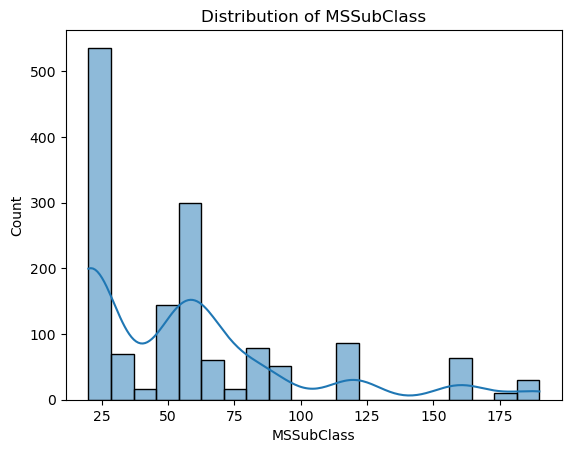

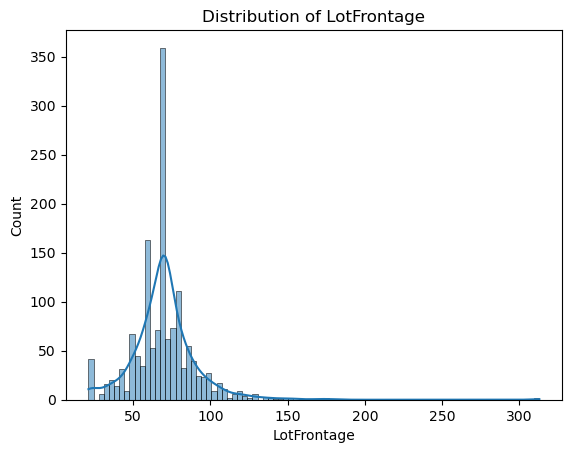

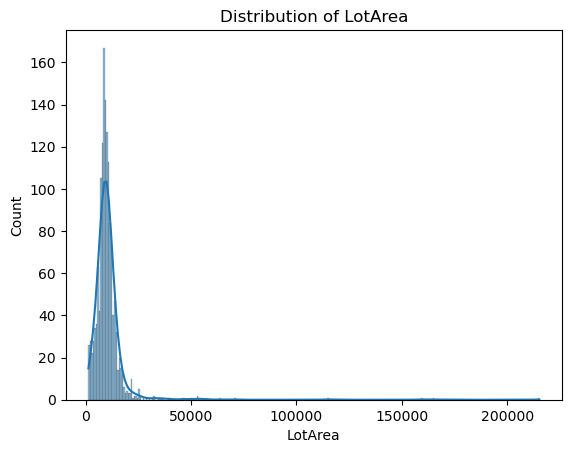

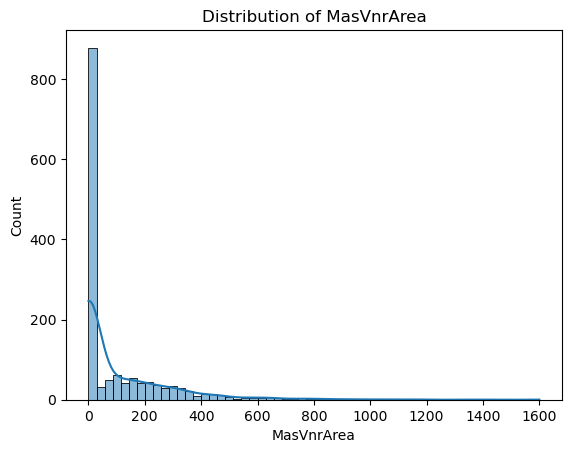

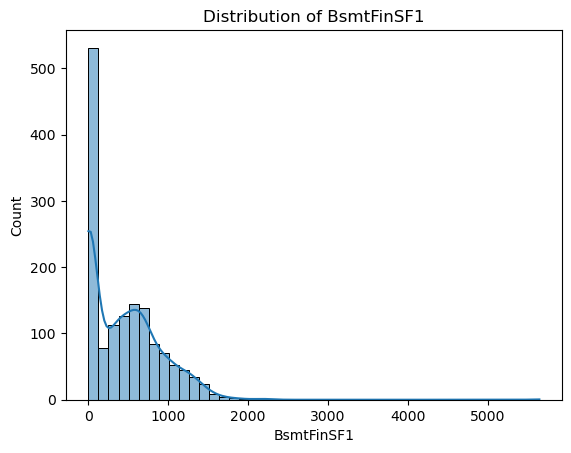

...

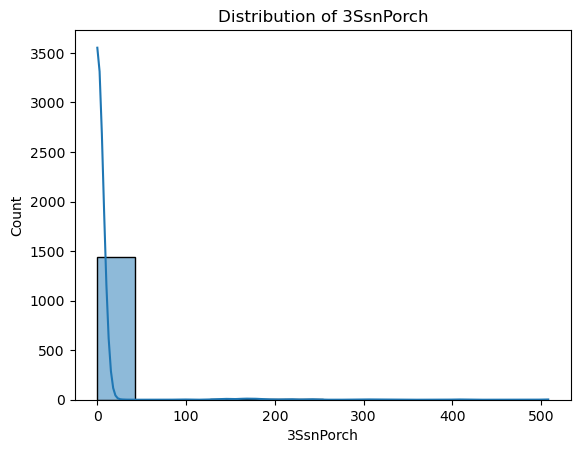

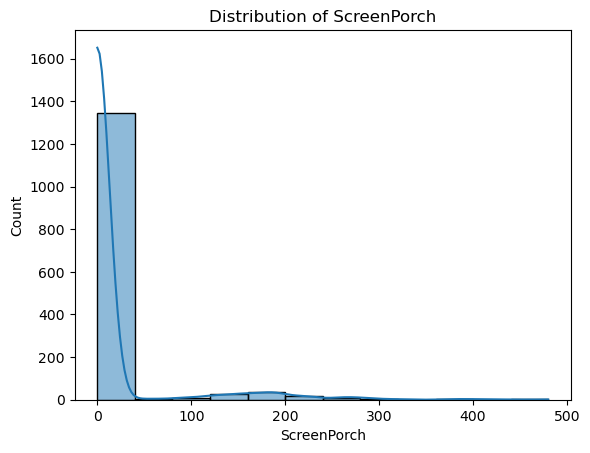

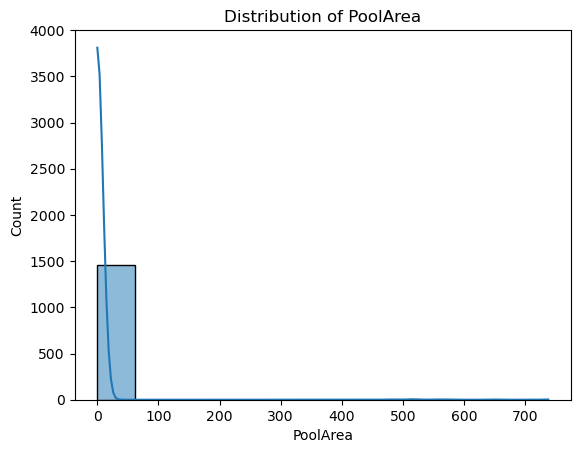

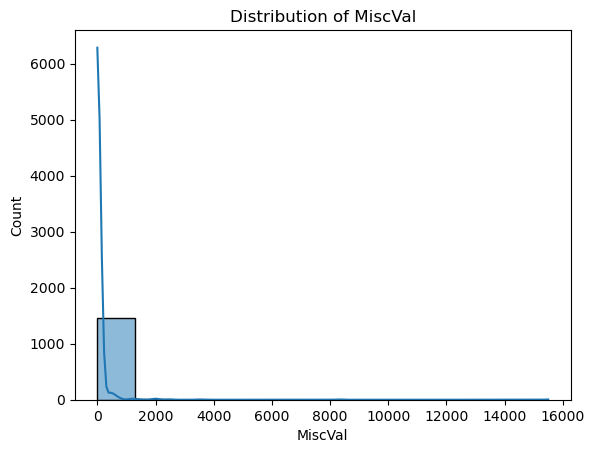

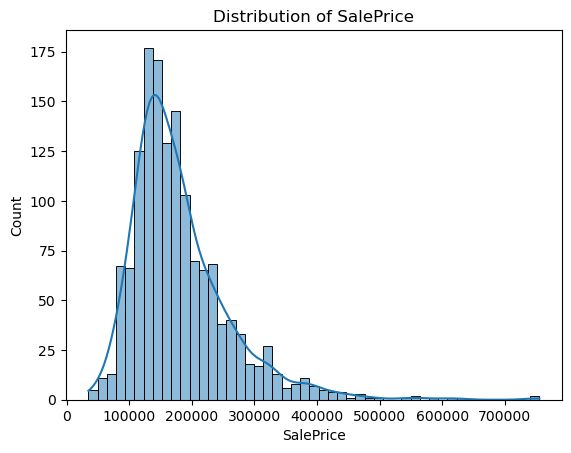

In [22]:
# Compute skewness of numeric columns
skewness = df_dropped.select_dtypes(include='number').skew()

# Select columns with high skew
skewed_cols = skewness[abs(skewness) > 0.75].index.tolist()

import seaborn as sns
import matplotlib.pyplot as plt

for col in skewed_cols:
    sns.histplot(df_dropped[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

### convert object

In [23]:
#df_dropped[['MSSubClass']] = df_dropped[['MSSubClass']].astype('object')


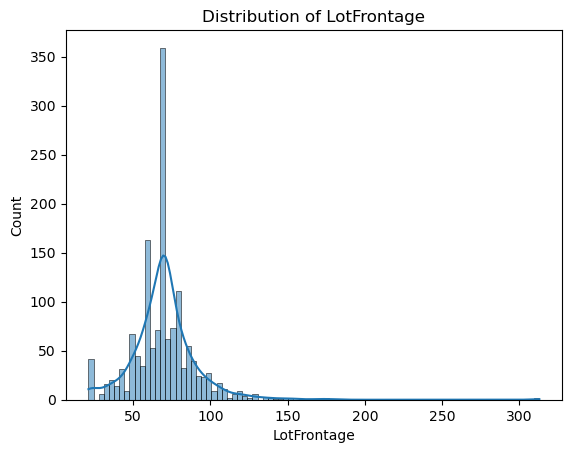

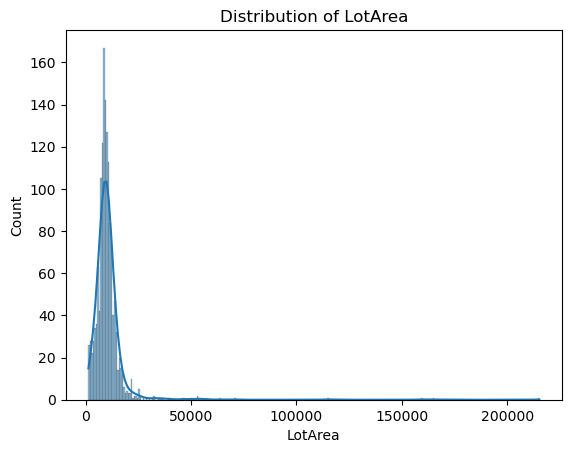

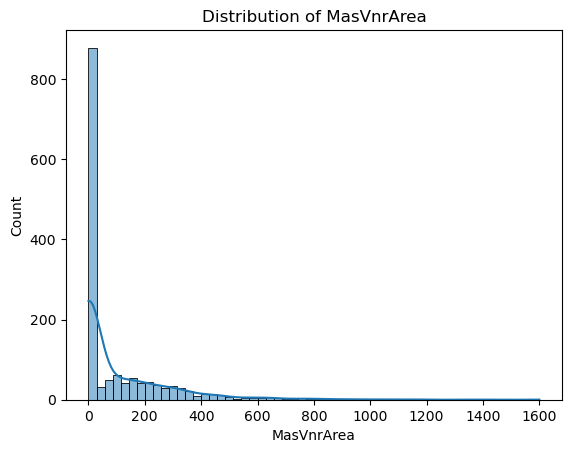

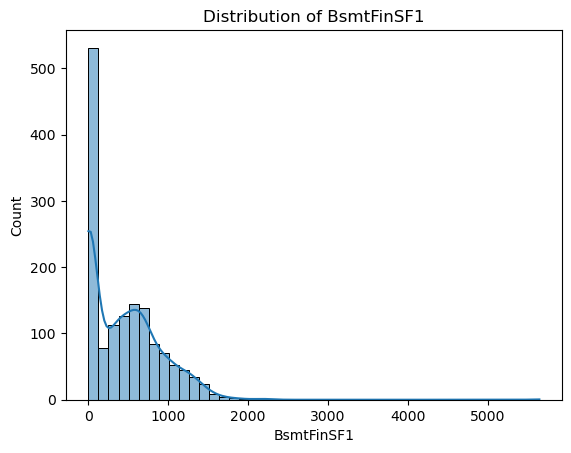

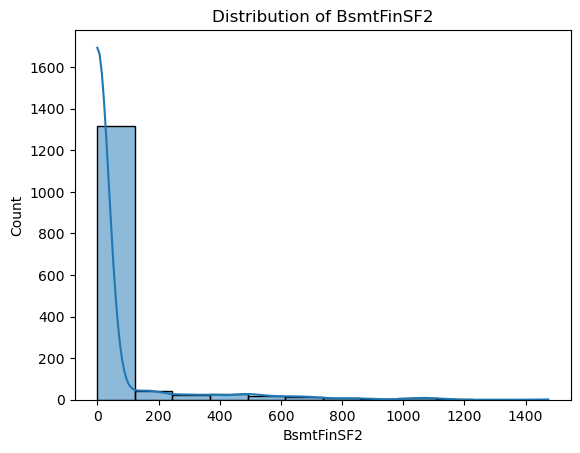

...

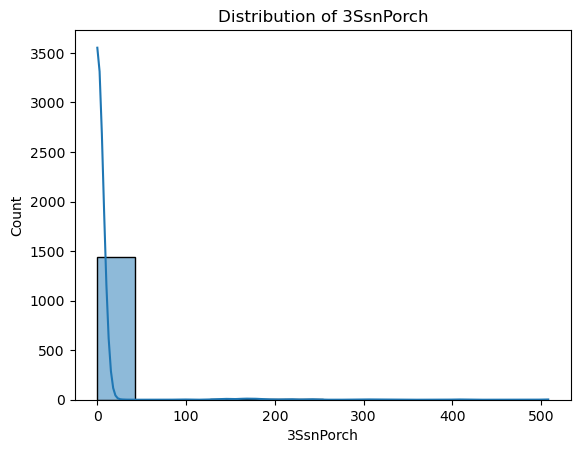

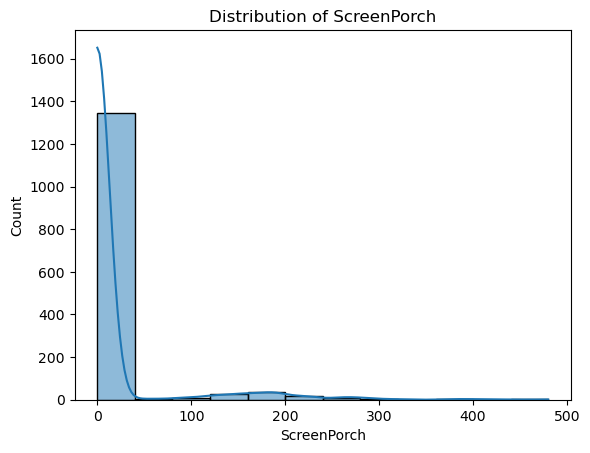

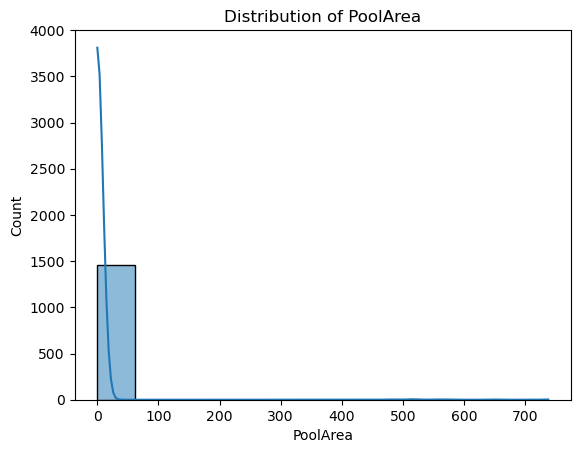

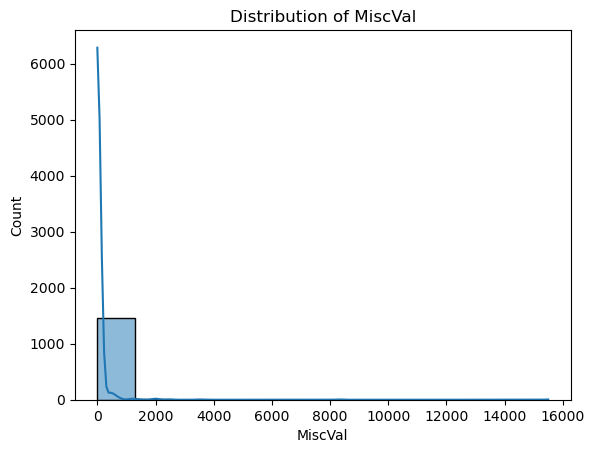

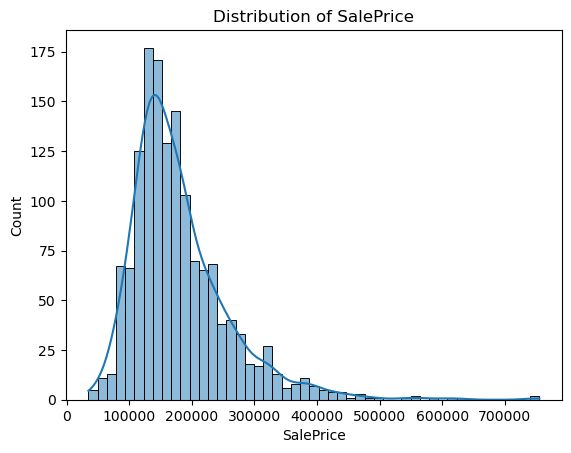

In [24]:
# Compute skewness of numeric columns
skewness = df_dropped.select_dtypes(include='number').skew()

# Select columns with high skew
skewed_cols = skewness[abs(skewness) > 0.75].index.tolist()

import seaborn as sns
import matplotlib.pyplot as plt

for col in skewed_cols:
    sns.histplot(df_dropped[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

In [26]:
df_dropped.select_dtypes(include='number').columns.tolist()

['Id',
 'LotFrontage',
 'LotArea',
 'OverallQual',
 'OverallCond',
 'MasVnrArea',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 '1stFlrSF',
 '2ndFlrSF',
 'LowQualFinSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'KitchenAbvGr',
 'TotRmsAbvGrd',
 'Fireplaces',
 'GarageYrBlt',
 'GarageCars',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'EnclosedPorch',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal',
 'SalePrice',
 'HouseAge',
 'YearsSinceRemod',
 'TimeIndex']

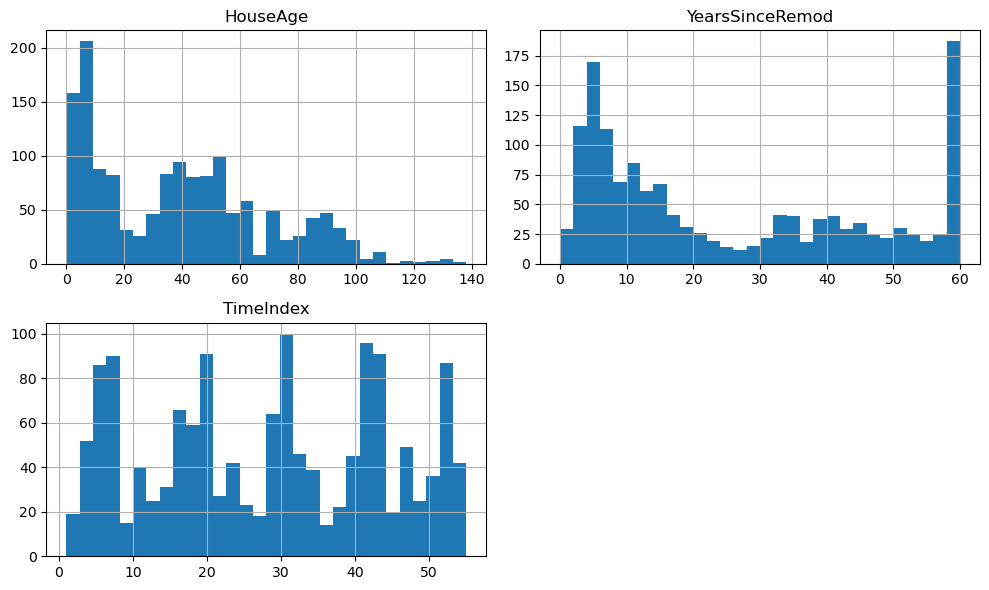

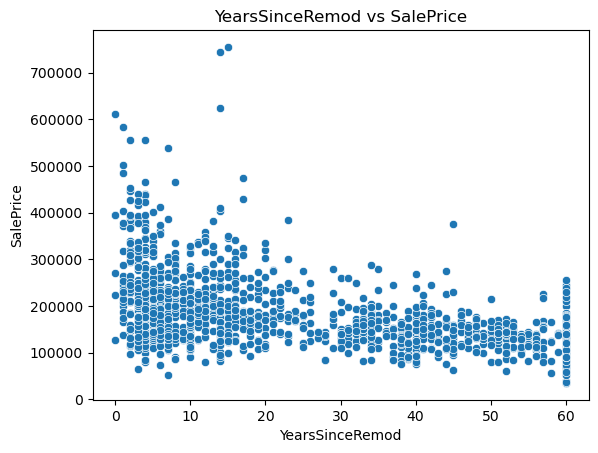

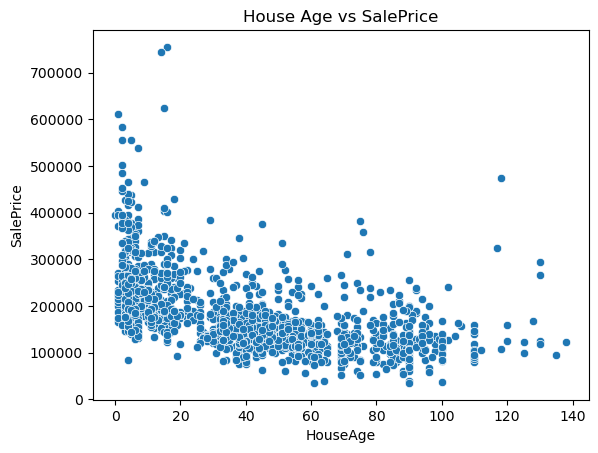

In [27]:

import matplotlib.pyplot as plt

df_dropped[['HouseAge', 'YearsSinceRemod', 'TimeIndex']].hist(bins=30, figsize=(10, 6))
plt.tight_layout()
plt.show()

## House age variable

#, 'TimeIndex' periodical not correlated sales price
sns.scatterplot(x='YearsSinceRemod', y='SalePrice', data=df_dropped)
plt.title("YearsSinceRemod vs SalePrice")
plt.show()

sns.scatterplot(x='HouseAge', y='SalePrice', data=df_dropped)
plt.title("House Age vs SalePrice")
plt.show()

In [27]:
for col in ['LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
 'MiscVal']:
    print(f"\nValue counts for '{col}':")
    print(df_dropped[col].value_counts().sort_index())


Value counts for 'LowQualFinSF':
LowQualFinSF
0      1434
53        1
80        3
120       1
144       1
156       1
205       1
232       1
234       1
360       2
371       1
384       1
390       1
392       1
397       1
420       1
473       1
479       1
481       1
513       1
514       1
515       1
528       1
572       1
Name: count, dtype: int64

Value counts for 'BsmtHalfBath':
BsmtHalfBath
0    1378
1      80
2       2
Name: count, dtype: int64

Value counts for 'KitchenAbvGr':
KitchenAbvGr
0       1
1    1392
2      65
3       2
Name: count, dtype: int64

Value counts for 'EnclosedPorch':
EnclosedPorch
0      1252
19        1
20        1
24        1
30        1
       ... 
301       1
318       1
330       1
386       1
552       1
Name: count, Length: 120, dtype: int64

Value counts for '3SsnPorch':
3SsnPorch
0      1436
23        1
96        1
130       1
140       1
144       2
153       1
162       1
168       3
180       2
182       1
196       1
216       2
238   

## 1.6 correct skewness

In [ ]:
#case 1: only binary no log

#Most houses don't have low-quality finished square footage.
#Very few do, with highly varied amounts.
cols_to_binary_only_0 = ['BsmtHalfBath', 'EnclosedPorch', 'ScreenPorch']

for col in cols_to_binary_only_0:
    df_dropped[f'Has{col}'] = (df_dropped[col] > 0).astype(int)
    df_dropped.drop(columns=[col], inplace=True)

# = 1 or not

df_dropped['HasKitchen'] = (df_dropped['KitchenAbvGr'] == 1).astype(int)
df_dropped.drop(columns=['KitchenAbvGr'], inplace=True)


#case 2: binary+log

cols = ['MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', '2ndFlrSF', 'WoodDeckSF', 'OpenPorchSF']  # Replace with actual column names

for col in cols:
    df_dropped[f'Has{col}'] = (df_dropped[col] > 0).astype(int)
    df_dropped[f'{col}_log'] = np.log1p(df_dropped[col])

#case 3: just drop 
df_dropped.drop(columns=['LowQualFinSF','3SsnPorch', 'PoolArea', 'MiscVal'], inplace=True)

# case 4: log only

#correlation = df_cat_quant['HouseAge'].corr(df_cat_quant['YearsSinceRemod'], method='pearson')
#print(f"Pearson correlation: {correlation:.3f}")
df_dropped.drop(columns=[ 'TimeIndex'], inplace=True)# cyclique, pas significative

# List of variables to transform
vars_to_log = ['LotFrontage', 'LotArea', 'TotalBsmtSF', 'GrLivArea',  'SalePrice', 'BsmtUnfSF', '1stFlrSF']

# Create log-transformed versions with "_log" suffix
for col in vars_to_log:
    df_dropped[col + '_log'] = np.log1p(df_dropped[col])  # log1p handles zero safely

# Drop the original columns
df_dropped.drop(columns=vars_to_log, inplace=True)

### cap

In [33]:
df_dropped.select_dtypes(include=['number']).columns

Index(['Id', 'OverallQual', 'OverallCond', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', '2ndFlrSF', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt',
       'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'HouseAge',
       'YearsSinceRemod', 'HasBsmtHalfBath', 'HasEnclosedPorch',
       'HasScreenPorch', 'HasKitchen', 'HasMasVnrArea', 'MasVnrArea_log',
       'HasBsmtFinSF1', 'BsmtFinSF1_log', 'HasBsmtFinSF2', 'BsmtFinSF2_log',
       'HasBsmtUnfSF', 'BsmtUnfSF_log', 'Has2ndFlrSF', '2ndFlrSF_log',
       'HasWoodDeckSF', 'WoodDeckSF_log', 'HasOpenPorchSF', 'OpenPorchSF_log',
       'LotFrontage_log', 'LotArea_log', 'TotalBsmtSF_log', 'GrLivArea_log',
       'SalePrice_log', '1stFlrSF_log'],
      dtype='object')

In [29]:
[col for col in df_dropped.select_dtypes(include='number').columns if df_dropped[col].nunique() <= 10]

['OverallQual',
 'OverallCond',
 'BsmtFullBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'Fireplaces',
 'GarageCars',
 'PoolArea',
 'HasBsmtHalfBath',
 'HasEnclosedPorch',
 'HasScreenPorch',
 'HasKitchen',
 'HasMasVnrArea',
 'HasBsmtFinSF1',
 'HasBsmtFinSF2',
 'HasBsmtUnfSF',
 'Has2ndFlrSF',
 'HasWoodDeckSF',
 'HasOpenPorchSF']

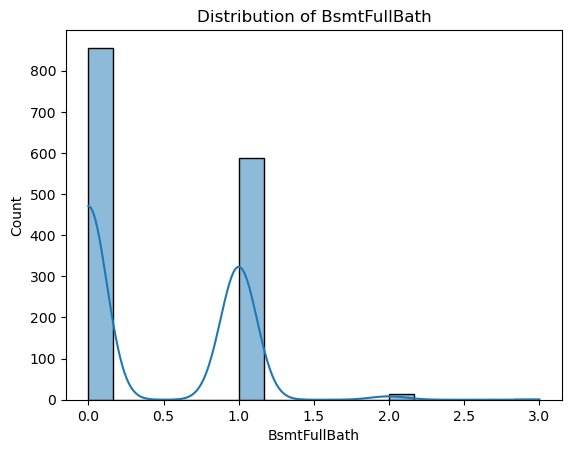

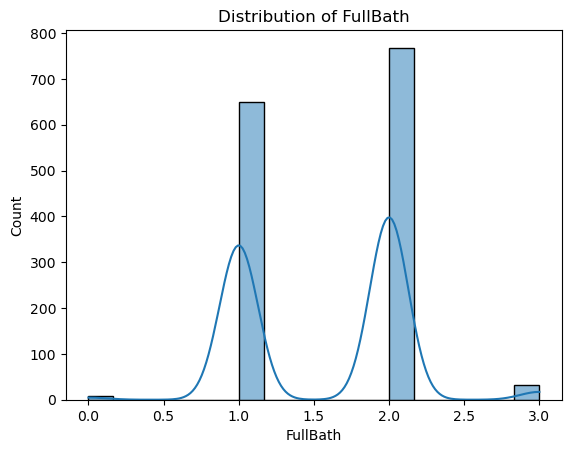

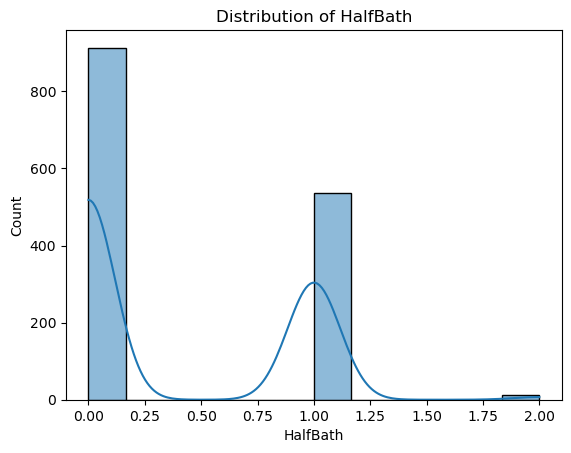

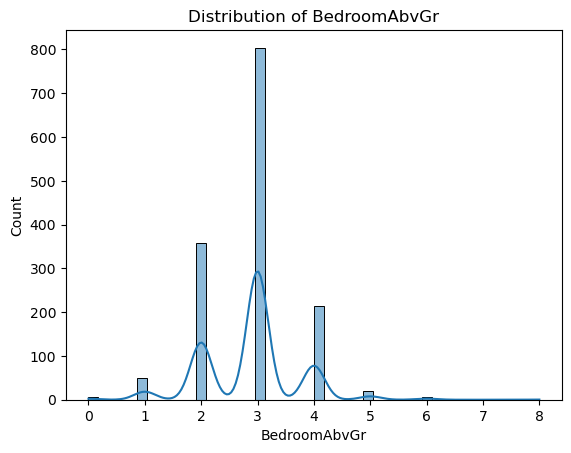

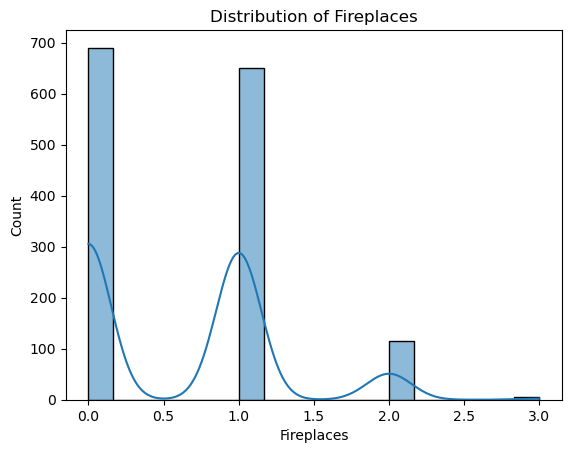

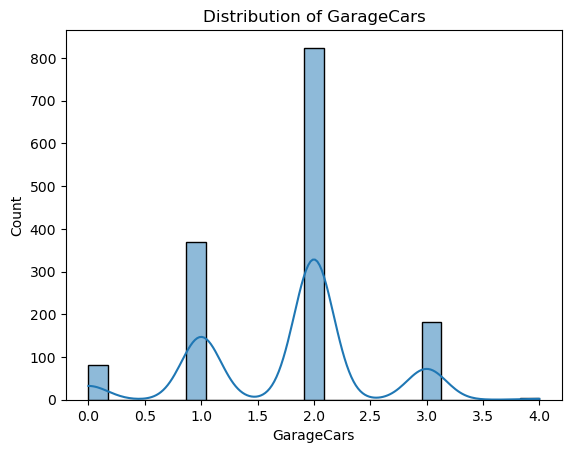

In [35]:
#won't affect Ridge Lasso, keep them
under_10 = ['BsmtFullBath',
 'FullBath',
 'HalfBath',
 'BedroomAbvGr',
 'Fireplaces',
 'GarageCars']

for col in under_10:
    sns.histplot(df_dropped[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

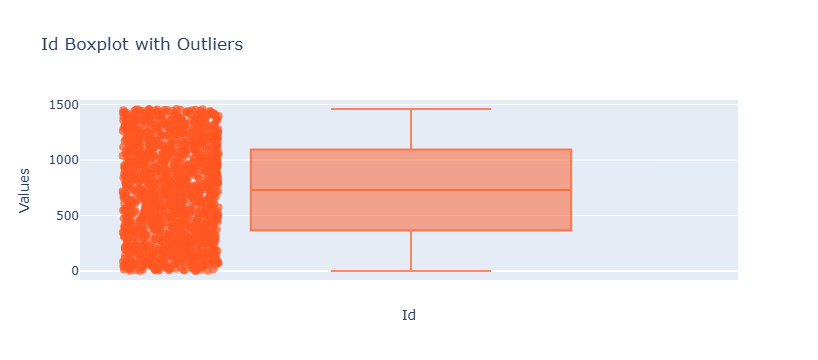

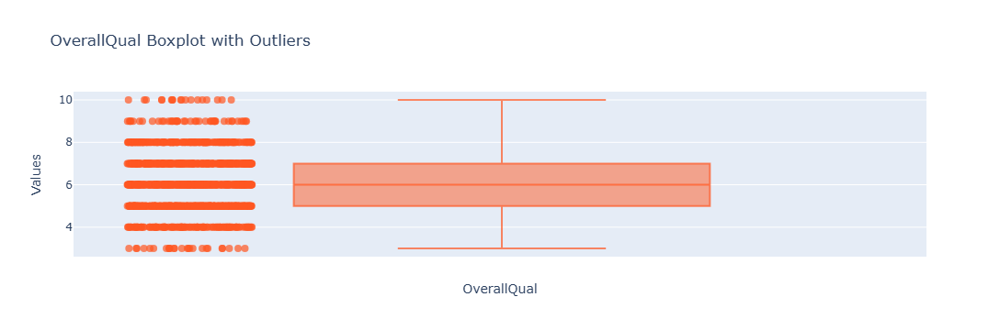

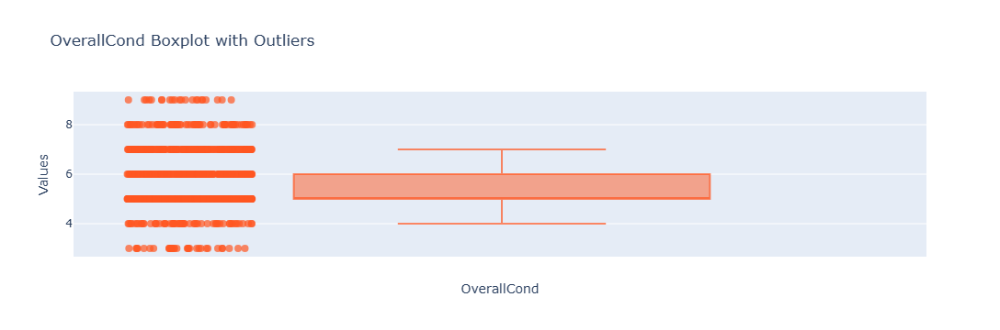

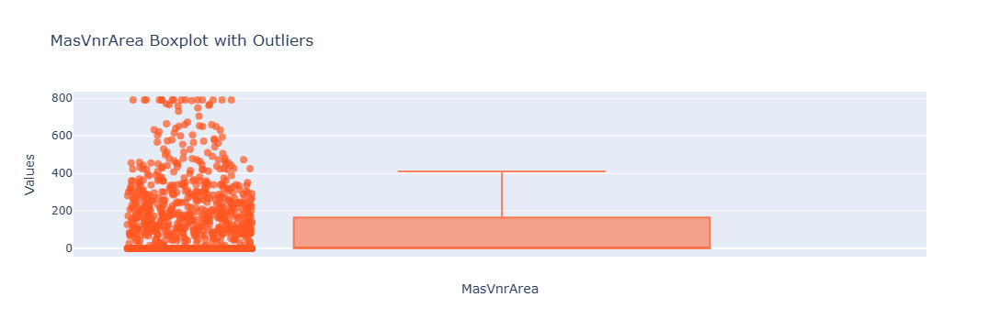

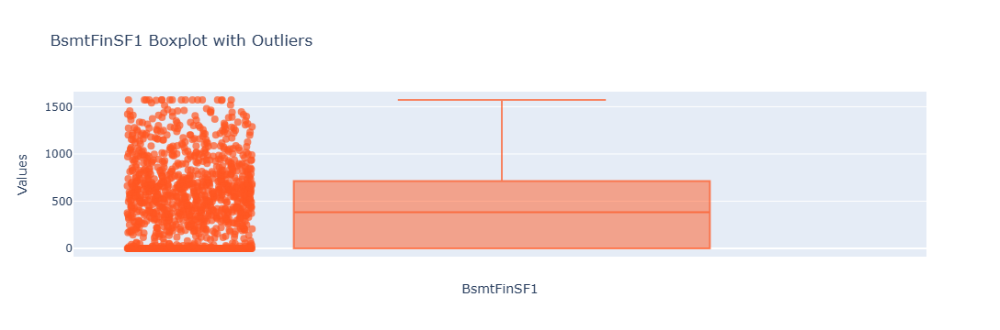

...

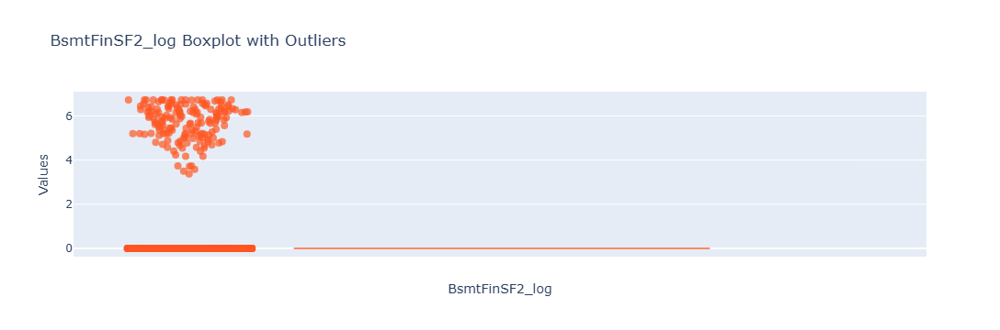

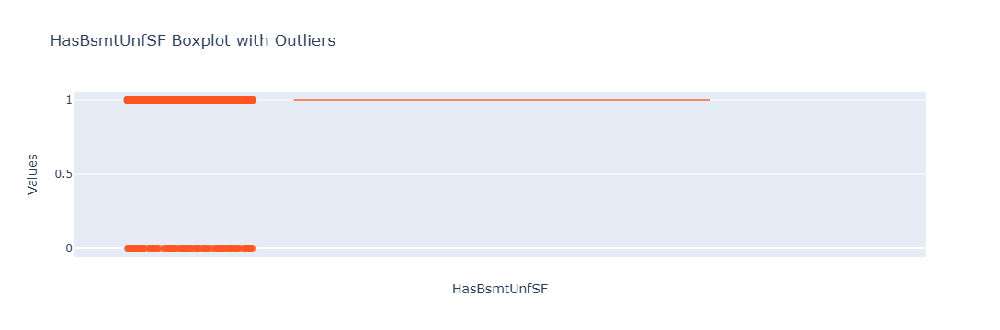

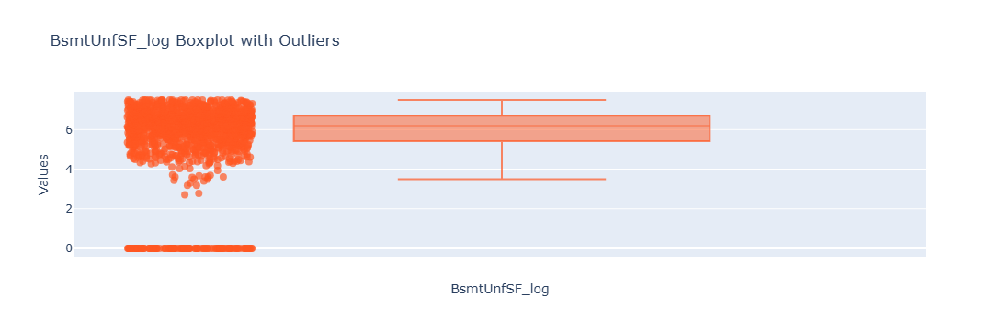

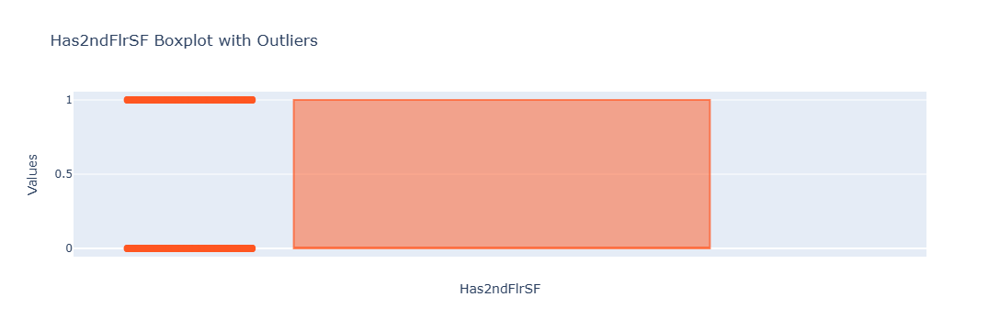

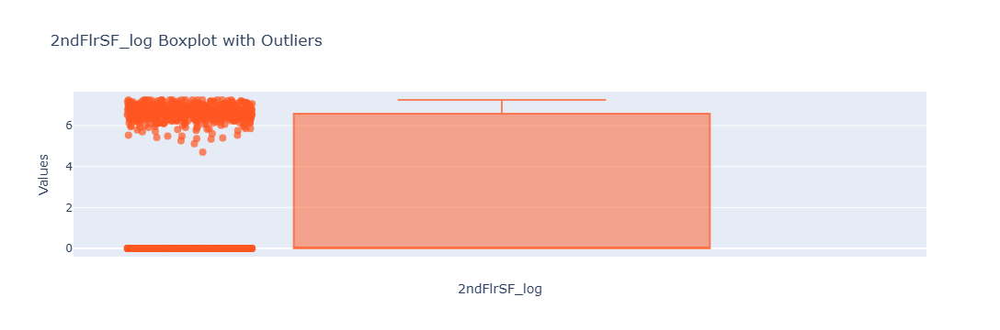

In [30]:
# cap outliers
#outliers cap

num_features = num_features = [col for col in df_dropped.select_dtypes(include='number') if col != 'Id']
 
# Store the limits for each column
caps = {}

for col in num_features:
    q_low = df_dropped[col].quantile(0.01)
    q_high = df_dropped[col].quantile(0.99)
    
    # Save the thresholds
    caps[col] = (q_low, q_high)
    
    # Apply clipping
    df_dropped[col] = df_dropped[col].clip(lower=q_low, upper=q_high)

import plotly.express as px

# Loop through all numeric columns and create an interactive boxplot for each
for col in df_dropped.select_dtypes(include=['number']).columns:
    fig = px.box(df_dropped, y=col, points="all", title=f'{col} Boxplot with Outliers')
    fig.update_traces(marker=dict(color='rgba(255, 87, 34, 0.7)', size=8))  # Customize outlier markers
    fig.update_layout(
        xaxis_title=col,
        yaxis_title="Values",
    )
    fig.show()

# Check variables

In [31]:


# Step 1: Detect categorical variables (object or category types)
categorical_vars = df_dropped.select_dtypes(include=['object', 'category']).columns.tolist()

# Step 2: Detect quantitative variables (number types)
quantitative_vars = df_dropped.select_dtypes(include=['number']).columns.tolist()

# Optional Step: Remove variables that are technically numbers but conceptually categorical
# For example: if you consider 'Rating' or 'YearBuilt' as categorical:
#quantitative_vars = [col for col in quantitative_vars if col not in ['Rating']]  # example

# Print results
print("Categorical Variables:", categorical_vars)
print("Quantitative Variables:", quantitative_vars)

Categorical Variables: ['MSSubClass', 'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition']
Quantitative Variables: ['Id', 'OverallQual', 'OverallCond', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', '2ndFlrSF', 'LowQualFinSF', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', '3SsnPorch', 'PoolArea', 'MiscVal', 'HouseAge', 'YearsSinceRemod', 'HasBsmtHalfBath', 'HasEncl

# Correlations

In [32]:
target_col = 'SalePrice_log'

# Select numeric columns
quantitative_vars = df_dropped.select_dtypes(include='number')

# Compute Pearson correlations with target
correlations = quantitative_vars.corr()[target_col].sort_values(ascending=False)

# Drop self-correlation (Price vs Price = 1)
correlations = correlations.drop(labels=[target_col])

# Display result
print(correlations)


OverallQual         0.817365
GrLivArea_log       0.731506
GarageCars          0.689873
GarageArea          0.663215
1stFlrSF_log        0.608074
FullBath            0.604983
TotRmsAbvGrd        0.537089
GarageYrBlt         0.511028
Fireplaces          0.495062
OpenPorchSF_log     0.469442
HasOpenPorchSF      0.457158
MasVnrArea          0.436339
MasVnrArea_log      0.422748
LotArea_log         0.405227
HasMasVnrArea       0.393759
BsmtFinSF1          0.383210
TotalBsmtSF_log     0.371713
OpenPorchSF         0.353940
LotFrontage_log     0.350148
WoodDeckSF_log      0.345363
WoodDeckSF          0.340865
HalfBath            0.328874
HasWoodDeckSF       0.322512
2ndFlrSF            0.311677
BsmtFullBath        0.240639
BedroomAbvGr        0.218612
BsmtUnfSF_log       0.210222
BsmtFinSF1_log      0.206278
HasBsmtUnfSF        0.194204
2ndFlrSF_log        0.180244
HasBsmtFinSF1       0.161714
HasKitchen          0.156005
Has2ndFlrSF         0.150766
HasScreenPorch      0.097633
3SsnPorch     

# Categorical variable (missing+rare categories)

In [39]:
def clean_categorical_variables(
    df, 
    target_col='SalePrice_log', 
    threshold=0.03, 
    tol=0.10, 
    min_count=30
):
    """
    Cleans all categorical variables:
    - Fills missing values
    - Groups rare non-predictive categories into 'Other'
    - Merges 'Other' into closest price category if too small

    Returns modified DataFrame.
    """
    df = df.copy()
    cat_cols = df.select_dtypes(include=['object', 'category']).columns
    global_mean = df[target_col].mean()
    mappings = {}
    for col in cat_cols:
        # Step 1: Fill missing
        df[col] = df[col].fillna("Missing")

        # Step 2: Frequency and stats
        freq = df[col].value_counts(normalize=True)
        rare_cats = freq[freq < threshold].index
        stats = df.groupby(col)[target_col].agg(['count', 'mean'])

        # Step 3: Decide which rare categories to keep
        keep_rare = []
        group_rare = []

        for cat in rare_cats:
            count = stats.loc[cat, 'count']
            mean = stats.loc[cat, 'mean']
            deviation = abs(mean - global_mean) / global_mean

            if count >= min_count and deviation > tol:
                keep_rare.append(cat)
            else:
                group_rare.append(cat)

        # Step 4: Replace rare with 'Other'
        df[col] = df[col].apply(lambda x: 'Other' if x in group_rare else x)

        final_merge_target = None
        # Step 5: Merge 'Other' if too small
        if 'Other' in df[col].values:
            other_mask = df[col] == 'Other'
            if other_mask.sum() < min_count:
                other_mean = df.loc[other_mask, target_col].mean()
                means = df.loc[~other_mask].groupby(col)[target_col].mean()
                final_merge_target = means.sub(other_mean).abs().idxmin()
                df.loc[other_mask, col] = final_merge_target
                print(f"'{col}': 'Other' merged into '{final_merge_target}' (closest avg price)")

 # Save mapping
        mappings[col] = {
            'group_rare': group_rare,
            'final_merge_target': final_merge_target
        }

    return df, mappings



df_rare_cat, cat_mappings = clean_categorical_variables(df_dropped)


'MSZoning': 'Other' merged into 'RM' (closest avg price)

C:\Users\berra\AppData\Local\Temp\ipykernel_12920\3436336146.py:22: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`




'Street': 'Other' merged into 'Pave' (closest avg price)
'Utilities': 'Other' merged into 'AllPub' (closest avg price)
'LotConfig': 'Other' merged into 'CulDSac' (closest avg price)
'LandSlope': 'Other' merged into 'Mod' (closest avg price)
'Condition2': 'Other' merged into 'Norm' (closest avg price)
'RoofMatl': 'Other' merged into 'CompShg' (closest avg price)
'ExterQual': 'Other' merged into 'TA' (closest avg price)
'HeatingQC': 'Other' merged into 'Fa' (closest avg price)
'GarageQual': 'Other' merged into 'TA' (closest avg price)


In [44]:
#remove variables with one category

# Step 1: Identify columns dropped from training
cols_dropped_one_cat = df_dropped.columns[df_dropped.nunique(dropna=False) <= 1]
df_dropped = df_dropped.loc[:, df_dropped.nunique(dropna=False) > 1]

# One-hot encode all object or category dtype columns
df_dropped = pd.get_dummies(df_dropped, drop_first=True)

In [45]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Step 1: Separate features and target
X_train = df_dropped.drop(columns=['Id', 'SalePrice_log'])  # Replace 'Price' with your actual target if named differently
y = df_dropped['SalePrice_log']

# Step 3: Define regression model
model = LinearRegression()

model.fit(X_train, y)

# Step 4: Cross-validation setup
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Step 5: Run cross-validation and evaluate using negative RMSE
scores = cross_val_score(model, X_train, y, scoring='neg_root_mean_squared_error', cv=cv)

# Step 6: Print results
print("Cross-validated RMSE scores:", -scores)
print("Average RMSE:", -scores.mean())

Cross-validated RMSE scores: [0.14379441 0.10595565 0.14794124 0.12804042 0.12931704]
Average RMSE: 0.13100975167175755


In [ ]:
#the best
from sklearn.linear_model import Ridge
model = Ridge(alpha=1)

model.fit(X_train, y)

# Step 4: Cross-validation setup
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Step 5: Run cross-validation and evaluate using negative RMSE
scores = cross_val_score(model, X_train, y, scoring='neg_root_mean_squared_error', cv=cv)

# Step 6: Print results
print("Cross-validated RMSE scores:", -scores)
print("Average RMSE:", -scores.mean())

In [50]:
from sklearn.linear_model import Lasso
model = Lasso(alpha=0.01)

model.fit(X_train, y)

# Step 4: Cross-validation setup
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Step 5: Run cross-validation and evaluate using negative RMSE
scores = cross_val_score(model, X_train, y, scoring='neg_root_mean_squared_error', cv=cv)

# Step 6: Print results
print("Cross-validated RMSE scores:", -scores)
print("Average RMSE:", -scores.mean())

Cross-validated RMSE scores: [0.11973293 0.10578386 0.14337678 0.11658394 0.10860751]
Average RMSE: 0.11881700310634362


In [ ]:
0.12272217996122939-0.12272217996122939

# Test Quantitative columns (outliers capping...)

In [ ]:
# test

#from Id	LotArea	LotShape	BldgType	HouseStyle	BsmtFinSF1	BsmtFinType2	BsmtFinSF2	BsmtUnfSF	TotalBsmtSF	1stFlrSF	2ndFlrSF	
#GrLivArea	BsmtFullBath	BsmtHalfBath	FullBath	HalfBath	BedroomAbvGr	KitchenAbvGr	TotRmsAbvGrd	GarageCars	GarageArea
#we drop
d_test = pd.read_csv('test.csv') 

## 2.1 convert types

In [ ]:
d_test[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']] = d_test[['MSSubClass', 'MoSold', 'YearBuilt', 'YearRemodAdd', 'YrSold']].astype('object')

## 2.2 drop most missing

In [ ]:
test_df.drop(columns=dropped_columns_most_missing, inplace=True)

## 2.3 fill na categorical

In [ ]:
# Identify categorical columns
cat_cols = d_test.select_dtypes(include=['object', 'category']).columns

# Fill missing values with "Missing"
d_test[cat_cols] = d_test[cat_cols].fillna("Missing")

## 2.4 fill na with means of train

In [ ]:
# Imputation dans le test set (numeric)
d_test.fillna(means, inplace=True)

## 2.5 create variables

In [ ]:
#'YearBuilt', 'YearRemodAdd, 'MoSold', 'YrSold' convert to quantitative
# List of columns to convert
columns_to_convert = ['YearBuilt', 'YearRemodAdd', 'MoSold', 'YrSold']

# Convert each to integer safely
for col in columns_to_convert:
    d_test.loc[:, col] = d_test[col].astype(int)

# Set reference year
reference_year = d_test['YrSold'].max()

# Create quantitative features safely
d_test.loc[:, 'HouseAge'] = reference_year - d_test['YearBuilt']
d_test.loc[:, 'YearsSinceRemod'] = reference_year - d_test['YearRemodAdd']


d_test = d_test.drop([
    'YearBuilt', 'YearRemodAdd', 'YrSold', 'MoSold'
], axis=1) 

# Convert object columns to numeric, forcing errors to NaN
cols_to_convert = ['HouseAge', 'YearsSinceRemod']
d_test[cols_to_convert] = d_test[cols_to_convert].apply(pd.to_numeric, errors='coerce')

## 2.6 correct skewness

In [ ]:
#case 1: only binary no log

#Most houses don't have low-quality finished square footage.
#Very few do, with highly varied amounts.
cols_to_binary_only_0 = ['BsmtHalfBath', 'EnclosedPorch', 'ScreenPorch']

for col in cols_to_binary_only_0:
    d_test[f'Has{col}'] = (d_test[col] > 0).astype(int)
    d_test.drop(columns=[col], inplace=True)

# = 1 or not

d_test['HasKitchen'] = (d_test['KitchenAbvGr'] == 1).astype(int)
d_test.drop(columns=['KitchenAbvGr'], inplace=True)


#case 2: binary+log

cols = ['MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', '2ndFlrSF', 'WoodDeckSF', 'OpenPorchSF']  # Replace with actual column names

for col in cols:
    d_test[f'Has{col}'] = (d_test[col] > 0).astype(int)
    d_test[f'{col}_log'] = np.log1p(d_test[col])

#case 3: just drop 
d_test.drop(columns=['LowQualFinSF','3SsnPorch', 'PoolArea', 'MiscVal'], inplace=True)

# case 4: log only

#correlation = df_cat_quant['HouseAge'].corr(df_cat_quant['YearsSinceRemod'], method='pearson')
#print(f"Pearson correlation: {correlation:.3f}")
d_test.drop(columns=[ 'TimeIndex'], inplace=True)# cyclique, pas significative

# List of variables to transform
vars_to_log = ['LotFrontage', 'LotArea', 'TotalBsmtSF', 'GrLivArea',  'SalePrice', 'BsmtUnfSF', '1stFlrSF']

# Create log-transformed versions with "_log" suffix
for col in vars_to_log:
    d_test[col + '_log'] = np.log1p(d_test[col])  # log1p handles zero safely

# Drop the original columns
d_test.drop(columns=vars_to_log, inplace=True)

In [ ]:
d_test['HouseAge_log'] = np.log1p(d_test['HouseAge'])

d_test['YearsSinceRemod_log'] = np.log1p(d_test['YearsSinceRemod'])
d_test['RecentlyRemodeled'] = (d_test['YearsSinceRemod'] < 10).astype(int)
d_test['NeverRemodeled'] = (d_test['YearsSinceRemod'] == 60).astype(int)

d_test.drop(columns=[ 'HouseAge', 'YearsSinceRemod'], inplace=True)

In [ ]:
# Drop less useful or redundant columns
d_test = d_test.drop([
    'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', '1stFlrSF', '2ndFlrSF', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
    'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'GarageCars',
    'GarageYrBlt', 'MasVnrArea', 'KitchenQual', 'Fireplaces', 'FireplaceQu', 'PavedDrive', 'GarageQual', 'GarageCond',
    'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal',
    'MasVnrType', 'Fence', 'MiscFeature',
    'BsmtQual', 'BsmtCond', 'BsmtExposure'
], axis=1)



# Drop less useful or redundant columns
d_test = d_test.drop([
    'MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'LotShape', 'LandContour', 'Utilities',
    'LotConfig', 'LandSlope', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'ExterCond',
    'Heating', 'CentralAir', 'Electrical', 
    'Functional', 'GarageType', 'PoolQC', 'SaleCondition', 'SaleType'
], axis=1)


# we see low correlation with price by x/y axis
d_test = d_test.drop([
    'LowQualFinSF'
], axis=1) 

In [ ]:
missing_percent = d_test.isna().mean() * 100
missing_percent = missing_percent[missing_percent > 0].sort_values(ascending=False)

print("Missing value percentage per column:")
print(missing_percent.round(2))

In [ ]:
# Step 1: Get columns with missing values
missing_cols = d_test.columns[d_test.isna().any()]

# Step 2: Get number of unique values for just those columns
unique_counts = d_test[missing_cols].nunique(dropna=False).sort_values(ascending=False)

# Optional: merge with missing % for more insight
missing_percent = d_test[missing_cols].isna().mean() * 100
missing_info = pd.DataFrame({
    'Missing %': missing_percent.round(2),
    'Unique Values': unique_counts
}).sort_values(by='Missing %', ascending=False)

print(missing_info)

In [ ]:
# List of variables to transform
vars_to_log = ['LotFrontage', 'LotArea', 'TotalBsmtSF', 'GrLivArea', 'GarageArea']

# Create log-transformed versions with "_log" suffix
for col in vars_to_log:
    d_test[col + '_log'] = np.log1p(d_test[col])  # log1p handles zero safely

# Drop the original columns
d_test.drop(columns=vars_to_log, inplace=True)

num_features = ['LotFrontage_log', 'LotArea_log', 'TotalBsmtSF_log', 'GrLivArea_log', 'GarageArea_log'] 

for col in num_features:
    q_low, q_high = caps[col]
    d_test[col] = d_test[col].clip(lower=q_low, upper=q_high)

d_test['HasBasement'] = (d_test['TotalBsmtSF_log'] > 0).astype(int)
d_test['HasGarageArea'] = (d_test['GarageArea_log'] > 0).astype(int)

# Test categorical variables

In [ ]:
def apply_cat_mapping_to_test(df_test, mappings):
    df_test = df_test.copy()

    for col, info in mappings.items():
        df_test[col] = df_test[col].fillna("Missing")

        # Replace rare categories with 'Other'
        df_test[col] = df_test[col].apply(lambda x: 'Other' if x in info['group_rare'] else x)

        # Merge 'Other' into target if needed
        if info['final_merge_target'] is not None:
            df_test[col] = df_test[col].replace('Other', info['final_merge_target'])

    return df_test
# Apply same mappings to test
d_test = apply_cat_mapping_to_test(d_test, cat_mappings)



# Step 2: Drop same columns from test set
d_test = d_test.drop(columns=cols_dropped_one_cat, errors='ignore')

In [ ]:
# One-hot encode test set
X_test = pd.get_dummies(d_test, drop_first=True)
X_test = d_test.drop(columns=['Id'], errors='ignore') 
# Align with training columns (very important!)
X_test_aligned = X_test.reindex(columns=X_train.columns, fill_value=0)

y_pred_log = model.predict(X_test_aligned)
y_pred = np.expm1(y_pred_log)  # reverse np.log1p()
d_test['SalePrice'] = y_pred
d_test[['Id', 'SalePrice']].to_csv("predictions.csv", index=False)

In [ ]:
import os
os.getcwd()